<a href="https://colab.research.google.com/github/charu6969/IRIS-Classification/blob/main/zeroshotimgxaidetect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!unzip images.zip
%ls

In [18]:
from google.colab import drive
drive.mount('/content/drive')

ValueError: mount failed

In [ ]:
!pip install attrdict
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-ex7_m53p
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-ex7_m53p
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done


In [ ]:
import numpy as np
from torch import nn
from transformers.models.gpt2 import GPT2LMHeadModel, GPT2Tokenizer
from transformers.models.gpt_neo import GPTNeoForCausalLM
import torch
import clip
from PIL import Image
from datetime import datetime
import sys

In [ ]:
def log_info(text, verbose=True):
    if verbose:
        dt_string = datetime.now().strftime("%d/%m/%Y %H:%M:%S")
        print(f'{dt_string} | {text}')
        sys.stdout.flush()


def add_context(x, y):
    return (x[0] + y[0], x[1] + y[1])


def convert_models_to_fp32(model):
    for p in model.parameters():
        p.data = p.data.float()

In [ ]:
import numpy as np
import tensorflow as tf
import keras
import matplotlib as mpl
from IPython.display import Image as IPythonImage, display
import matplotlib.pyplot as plt

In [ ]:
model_builder = keras.applications.xception.Xception
img_size = (299, 299)
preprocess_input = keras.applications.xception.preprocess_input
decode_predictions = keras.applications.xception.decode_predictions

last_conv_layer_name = "block14_sepconv2_act"
# Make model
model = model_builder(weights="imagenet")

In [ ]:
!pip install git+https://github.com/facebookresearch/detectron2.git
!pip install opencv-python
!pip install matplotlib
!pip install captum

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-w6vi7mir
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-w6vi7mir
  Resolved https://github.com/facebookresearch/detectron2.git to commit b1c43ffbc995426a9a6b5c667730091a384e0fa4
  Preparing metadata (setup.py) ... done


In [ ]:
import numpy as np
import tensorflow as tf
import keras
import matplotlib as mpl
from IPython.display import Image as IPythonImage, display
import matplotlib.pyplot as plt

import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2.data import MetadataCatalog
from captum.attr import IntegratedGradients

# Import the Metadata class
from detectron2.data.catalog import Metadata

ModuleNotFoundError: No module named 'captum'

In [ ]:
class CLIPTextGenerator:
    def __init__(self,
                 seed=0,
                 lm_model='gpt-2',
                 forbidden_tokens_file_path='./forbidden_tokens.npy',
                 clip_checkpoints='./clip_checkpoints',
                 target_seq_length=15,
                 reset_context_delta=True,
                 num_iterations=5,
                 clip_loss_temperature=0.01,
                 clip_scale=1.,
                 ce_scale=0.2,
                 stepsize=0.3,
                 grad_norm_factor=0.9,
                 fusion_factor=0.99,
                 repetition_penalty=1.,
                 end_token='.',
                 end_factor=1.01,
                 forbidden_factor=20,
                 **kwargs):

        self.device = "cuda" if torch.cuda.is_available() else "cpu"

        # set Random seed
        torch.manual_seed(seed)
        np.random.seed(seed)

        # Initialize Language model
        self.context_prefix = ''

        if lm_model == 'gpt-neo':
            self.lm_tokenizer = GPT2Tokenizer.from_pretrained('EleutherAI/gpt-neo-125M')
            self.lm_model = GPTNeoForCausalLM.from_pretrained('EleutherAI/gpt-neo-125M', output_hidden_states=True)
        elif lm_model == 'gpt-2':
            self.lm_tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
            self.lm_model = GPT2LMHeadModel.from_pretrained('gpt2-medium', output_hidden_states=True)
            self.context_prefix = self.lm_tokenizer.bos_token

        self.lm_model.to(self.device)
        self.lm_model.eval()

        self.forbidden_tokens = np.load(forbidden_tokens_file_path)
        self.capital_letter_tokens = [self.lm_tokenizer.encoder[x] for x in self.lm_tokenizer.encoder.keys() if
                                      (x[0] == 'Ġ' and len(x) > 1 and x[1].isupper())]

        # Freeze LM weights
        for param in self.lm_model.parameters():
            param.requires_grad = False

        # Initialize CLIP
        self.clip, self.clip_preprocess = clip.load("ViT-B/32", device=self.device,
                                                    download_root=clip_checkpoints, jit=False)
        # convert_models_to_fp32(self.clip)

        # Init arguments
        self.target_seq_length = target_seq_length
        self.reset_context_delta = reset_context_delta
        self.num_iterations = num_iterations
        self.clip_loss_temperature = clip_loss_temperature
        self.clip_scale = clip_scale
        self.ce_scale = ce_scale
        self.stepsize = stepsize
        self.grad_norm_factor = grad_norm_factor
        self.fusion_factor = fusion_factor
        self.repetition_penalty = repetition_penalty
        self.end_token = self.lm_tokenizer.encode(end_token)[0]
        self.end_factor = end_factor
        self.ef_idx = 1
        self.forbidden_factor = forbidden_factor

    def get_img_feature(self, img_path, weights):
        imgs = [Image.open(x) for x in img_path]
        clip_imgs = [self.clip_preprocess(x).unsqueeze(0).to(self.device) for x in imgs]

        with torch.no_grad():
            image_fts = [self.clip.encode_image(x) for x in clip_imgs]

            if weights is not None:
                image_features = sum([x * weights[i] for i, x in enumerate(image_fts)])
            else:
                image_features = sum(image_fts)

            image_features = image_features / image_features.norm(dim=-1, keepdim=True)
            return image_features.detach()

    def get_txt_features(self, text):
        clip_texts = clip.tokenize(text).to(self.device)

        with torch.no_grad():
            text_features = self.clip.encode_text(clip_texts)

            text_features = text_features / text_features.norm(dim=-1, keepdim=True)
        return text_features.detach()

    def get_combined_feature(self, img_path, texts, weights_i, weights_t):
        imgs = [Image.open(x) for x in img_path]
        clip_imgs = [self.clip_preprocess(x).unsqueeze(0).to(self.device) for x in imgs]
        clip_texts = [clip.tokenize(x).to(self.device) for x in texts]

        with torch.no_grad():
            image_fts = [self.clip.encode_image(x) for x in clip_imgs]
            text_fts = [self.clip.encode_text(x) for x in clip_texts]

            features = sum([x * weights_i[i] for i, x in enumerate(image_fts)])
            if weights_t is not None:
                features += sum([x * weights_t[i] for i, x in enumerate(text_fts)])

            features = features / features.norm(dim=-1, keepdim=True)
            return features.detach()

    def run(self, image_features, cond_text, beam_size):
        self.image_features = image_features

        context_tokens = self.lm_tokenizer.encode(self.context_prefix + cond_text)

        output_tokens, output_text = self.generate_text(context_tokens, beam_size)

        return output_text

    def generate_text(self, context_tokens, beam_size):
        context_tokens = torch.tensor(context_tokens, device=self.device, dtype=torch.long).unsqueeze(0)

        gen_tokens = None
        scores = None
        seq_lengths = torch.ones(beam_size, device=self.device)
        is_stopped = torch.zeros(beam_size, device=self.device, dtype=torch.bool)

        for i in range(self.target_seq_length):
            probs = self.get_next_probs(i, context_tokens)
            logits = probs.log()

            if scores is None:
                scores, next_tokens = logits.topk(beam_size, -1)
                context_tokens = context_tokens.expand(beam_size, *context_tokens.shape[1:])
                next_tokens, scores = next_tokens.permute(1, 0), scores.squeeze(0)

                if gen_tokens is None:
                    gen_tokens = next_tokens
                else:
                    gen_tokens = gen_tokens.expand(beam_size, *gen_tokens.shape[1:])
                    gen_tokens = torch.cat((gen_tokens, next_tokens), dim=1)
            else:
                logits[is_stopped] = -float(np.inf)
                logits[is_stopped, 0] = 0
                scores_sum = scores[:, None] + logits
                seq_lengths[~is_stopped] += 1
                scores_sum_average = scores_sum / seq_lengths[:, None]
                scores_sum_average, next_tokens = scores_sum_average.view(-1).topk(
                    beam_size, -1)
                next_tokens_source = next_tokens // scores_sum.shape[1]
                seq_lengths = seq_lengths[next_tokens_source]
                next_tokens = next_tokens % scores_sum.shape[1]
                next_tokens = next_tokens.unsqueeze(1)
                gen_tokens = gen_tokens[next_tokens_source]
                gen_tokens = torch.cat((gen_tokens, next_tokens), dim=-1)
                context_tokens = context_tokens[next_tokens_source]
                scores = scores_sum_average * seq_lengths
                is_stopped = is_stopped[next_tokens_source]

            context_tokens = torch.cat((context_tokens, next_tokens), dim=1)
            is_stopped = is_stopped + next_tokens.eq(self.end_token).squeeze()

            ####
            tmp_scores = scores / seq_lengths
            tmp_output_list = gen_tokens.cpu().numpy()
            tmp_output_texts = [
                self.lm_tokenizer.decode(tmp_output)
                for tmp_output, tmp_length in zip(tmp_output_list, seq_lengths)
            ]
            tmp_order = tmp_scores.argsort(descending=True)
            tmp_output_texts = [tmp_output_texts[i] + ' %% ' + str(tmp_scores[i].cpu().numpy()) for i in tmp_order]
            log_info(tmp_output_texts, verbose=True)
            ####

            if is_stopped.all():
                break

        scores = scores / seq_lengths
        output_list = gen_tokens.cpu().numpy()
        output_texts = [
            self.lm_tokenizer.decode(output[: int(length)])
            for output, length in zip(output_list, seq_lengths)
        ]
        order = scores.argsort(descending=True)
        output_texts = [output_texts[i] for i in order]

        return context_tokens, output_texts

    def get_next_probs(self, i, context_tokens):
        last_token = context_tokens[:, -1:]

        if self.reset_context_delta and context_tokens.size(1) > 1:
            context = self.lm_model(context_tokens[:, :-1])["past_key_values"]

        # Logits of LM with unshifted context
        logits_before_shift = self.lm_model(context_tokens)["logits"]
        logits_before_shift = logits_before_shift[:, -1, :]
        probs_before_shift = nn.functional.softmax(logits_before_shift, dim=-1)

        if context:
            context = self.shift_context(i, context, last_token, context_tokens, probs_before_shift)

        lm_output = self.lm_model(last_token, past_key_values=context)
        logits, past = (
            lm_output["logits"],
            lm_output["past_key_values"],
        )
        logits = logits[:, -1, :]

        logits = self.update_special_tokens_logits(context_tokens, i, logits)

        probs = nn.functional.softmax(logits, dim=-1)
        probs = (probs ** self.fusion_factor) * (probs_before_shift ** (1 - self.fusion_factor))
        probs = probs / probs.sum()

        return probs

    def shift_context(self, i, context, last_token, context_tokens, probs_before_shift):
        context_delta = [tuple([np.zeros(x.shape).astype("float32") for x in p]) for p in context]

        window_mask = torch.ones_like(context[0][0]).to(self.device)

        for i in range(self.num_iterations):
            curr_shift = [tuple([torch.from_numpy(x).requires_grad_(True).to(device=self.device) for x in p_]) for p_ in
                          context_delta]

            for p0, p1 in curr_shift:
                p0.retain_grad()
                p1.retain_grad()

            shifted_context = list(map(add_context, context, curr_shift))

            shifted_outputs = self.lm_model(last_token, past_key_values=shifted_context)
            logits = shifted_outputs["logits"][:, -1, :]
            probs = nn.functional.softmax(logits, dim=-1)

            loss = 0.0

            # CLIP LOSS
            clip_loss, clip_losses = self.clip_loss(probs, context_tokens)
            loss += self.clip_scale * clip_loss

            # CE/Fluency loss
            ce_loss = self.ce_scale * ((probs * probs.log()) - (probs * probs_before_shift.log())).sum(-1)
            loss += ce_loss.sum()

            loss.backward()

            # ---------- Weights ----------
            combined_scores_k = -(ce_loss)
            combined_scores_c = -(self.clip_scale * torch.stack(clip_losses))

            # minmax
            if combined_scores_k.shape[0] == 1:
                tmp_weights_c = tmp_weights_k = torch.ones(*combined_scores_k.shape).to(self.device)
            else:
                tmp_weights_k = ((combined_scores_k - combined_scores_k.min())) / (
                        combined_scores_k.max() - combined_scores_k.min())
                tmp_weights_c = ((combined_scores_c - combined_scores_c.min())) / (
                        combined_scores_c.max() - combined_scores_c.min())

            tmp_weights = 0.5 * tmp_weights_k + 0.5 * tmp_weights_c
            tmp_weights = tmp_weights.view(tmp_weights.shape[0], 1, 1, 1)

            factor = 1

            # --------- Specific Gen ---------
            sep_grads = None

            for b in range(context_tokens.shape[0]):
                tmp_sep_norms = [[(torch.norm(x.grad[b:(b + 1)] * window_mask[b:(b + 1)]) + 1e-15) for x in p_]
                                 for p_ in curr_shift]

                # normalize gradients
                tmp_grad = [tuple([-self.stepsize * factor * (
                        x.grad[b:(b + 1)] * window_mask[b:(b + 1)] / tmp_sep_norms[i][
                    j] ** self.grad_norm_factor).data.cpu().numpy()
                                   for j, x in enumerate(p_)])
                            for i, p_ in enumerate(curr_shift)]
                if sep_grads is None:
                    sep_grads = tmp_grad
                else:
                    for l_index in range(len(sep_grads)):
                        sep_grads[l_index] = list(sep_grads[l_index])
                        for k_index in range(len(sep_grads[0])):
                            sep_grads[l_index][k_index] = np.concatenate(
                                (sep_grads[l_index][k_index], tmp_grad[l_index][k_index]), axis=0)
                        sep_grads[l_index] = tuple(sep_grads[l_index])
            final_grads = sep_grads

            # --------- update context ---------
            context_delta = list(map(add_context, final_grads, context_delta))

            for p0, p1 in curr_shift:
                p0.grad.data.zero_()
                p1.grad.data.zero_()

            new_context = []
            for p0, p1 in context:
                new_context.append((p0.detach(), p1.detach()))
            context = new_context

        context_delta = [tuple([torch.from_numpy(x).requires_grad_(True).to(device=self.device) for x in p_])
                         for p_ in context_delta]
        context = list(map(add_context, context, context_delta))

        new_context = []
        for p0, p1 in context:
            new_context.append((p0.detach(), p1.detach()))
        context = new_context

        return context

    def update_special_tokens_logits(self, context_tokens, i, logits):
        for beam_id in range(context_tokens.shape[0]):
            for token_idx in set(context_tokens[beam_id][-4:].tolist()):
                factor = self.repetition_penalty if logits[beam_id, token_idx] > 0 else (1 / self.repetition_penalty)
                logits[beam_id, token_idx] /= factor

            if i >= self.ef_idx:
                factor = self.end_factor if logits[beam_id, self.end_token] > 0 else (1 / self.end_factor)
                logits[beam_id, self.end_token] *= factor
            if i == 0:
                start_factor = 1.6
                factor = start_factor if logits[beam_id, self.end_token] > 0 else (1 / start_factor)
                logits[beam_id, self.end_token] /= factor

            for token_idx in list(self.forbidden_tokens):
                factor = self.forbidden_factor if logits[beam_id, token_idx] > 0 else (1 / self.forbidden_factor)
                logits[beam_id, token_idx] /= factor

        return logits

    def clip_loss(self, probs, context_tokens):
        for p_ in self.clip.transformer.parameters():
            if p_.grad is not None:
                p_.grad.data.zero_()

        top_size = 512
        _, top_indices = probs.topk(top_size, -1)

        prefix_texts = [self.lm_tokenizer.decode(x).replace(self.lm_tokenizer.bos_token, '') for x in context_tokens]

        clip_loss = 0
        losses = []
        for idx_p in range(probs.shape[0]):
            top_texts = []
            prefix_text = prefix_texts[idx_p]
            for x in top_indices[idx_p]:
                top_texts.append(prefix_text + self.lm_tokenizer.decode(x))
            text_features = self.get_txt_features(top_texts)

            with torch.no_grad():
                similiraties = (self.image_features @ text_features.T)
                target_probs = nn.functional.softmax(similiraties / self.clip_loss_temperature, dim=-1).detach()
                target_probs = target_probs.type(torch.float32)

            target = torch.zeros_like(probs[idx_p])
            target[top_indices[idx_p]] = target_probs[0]
            target = target.unsqueeze(0)
            cur_clip_loss = torch.sum(-(target * torch.log(probs[idx_p:(idx_p + 1)])))

            clip_loss += cur_clip_loss
            losses.append(cur_clip_loss)

        return clip_loss, losses

In [ ]:
import torch
import clip


def calc_best_clip(text_generator, captions, image_features):
    encoded_captions = [text_generator.clip.encode_text(clip.tokenize(c).to(text_generator.device)) for c in captions]
    encoded_captions = [x / x.norm(dim=-1, keepdim=True) for x in encoded_captions]
    best_clip_idx = (torch.cat(encoded_captions) @ image_features.t()).squeeze().argmax().item()
    best_clip = captions[best_clip_idx]

    return best_clip

In [ ]:
from enum import Enum
from dataclasses import dataclass

class GenType(Enum):
    Captioning = 0
    Arithmetic = 1
    RealWorld = 2
    OCR = 3

@dataclass
class Args:
    lm_model: str = "gpt-2"
    forbidden_tokens_file_path: str = '/content/forbidden_tokens.npy'
    target_seq_length: int = 15
    reset_context_delta: bool = True
    num_iterations: int = 5
    clip_loss_temperature: float = 0.01
    clip_scale: int = 1
    ce_scale: float = 0.2
    stepsize: float = 0.3
    repetition_penalty: int = 1
    end_token: str = "."
    forbidden_factor: int = 20
    beam_size: int = 5

def get_args(gen_type):
    args = Args()

    if gen_type == GenType.Captioning:
        args.cond_text = "Image of a"
        args.end_factor = 1.01
        args.fusion_factor = 0.99
        args.grad_norm_factor = 0.9
    elif gen_type == GenType.RealWorld:
        args.cond_text = "Image of"
        args.end_factor = 1.04
        args.fusion_factor = 0.99
        args.grad_norm_factor = 0.9
    elif gen_type == GenType.OCR:
        args.cond_text = "Image of text that says"
        args.end_factor = 1.04
        args.fusion_factor = 0.99
        args.grad_norm_factor = 0.9

    return args


In [ ]:
def get_img_array(img_path, size):

    img = keras.utils.load_img(img_path, target_size=size)

    array = keras.utils.img_to_array(img)

    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):

    grad_model = keras.models.Model(
        model.inputs, [model.get_layer(last_conv_layer_name).output, model.output]
    )


    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]


    grads = tape.gradient(class_channel, last_conv_layer_output)


    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))


    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)


    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def segmented_img(image_path):
  cfg = get_cfg()
  cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
  cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
  predictor = DefaultPredictor(cfg)

# Load the image
  # image_path = "party.jpg"
  image = cv2.imread(image_path)

# Run object detection and segmentation
  outputs = predictor(image)

# Get the predicted instances
  instances = outputs["instances"].to("cpu")

# Create new Metadata object without thing classes
  metadata = Metadata()
  metadata.thing_classes = []  # Remove label names

# Visualize the segmentation masks without label names
  visualizer = Visualizer(image[:, :, ::-1], metadata=metadata, instance_mode=ColorMode.IMAGE_BW)
  visualized_output = visualizer.draw_instance_predictions(instances)
  plt.figure(figsize=(10, 10))
  plt.imshow(visualized_output.get_image()[:, :, ::-1])
  plt.axis("off")
  plt.show()

In [ ]:
def save_and_display_gradcam(img_path, heatmap, cam_path="cam.jpg", alpha=0.4):
    # Load the original image
    img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = mpl.colormaps["jet"]

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.utils.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM
    display(IPythonImage(cam_path))



In [ ]:
# import torch

# # Define the path to your .pt model file
# model_path = "/content/clip_checkpoints/ViT-B-32.pt"

# # Load the model
# models = torch.load(model_path)

# # Ensure the model is in evaluation mode
# # models.eval()

Input image:


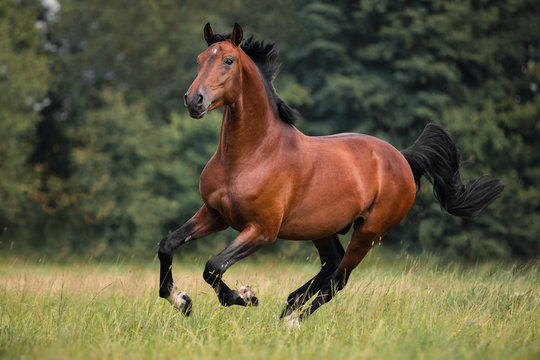

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/718 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.52G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

100%|████████████████████████████████████████| 338M/338M [00:02<00:00, 133MiB/s]


04/05/2024 03:08:00 | [' horse %% -1.9705327', ' Horse %% -3.6534526', ' man %% -4.4142704', ' dog %% -4.5801573', ' woman %% -4.998914']
04/05/2024 03:08:13 | [' horse. %% -3.2818828', ' man. %% -3.299487', ' horse in %% -3.4077678', ' horse on %% -3.604545', ' horse with %% -3.7738843']
04/05/2024 03:08:23 | [' horse on on %% -3.0022743', ' horse.! %% -3.2818828', ' man.! %% -3.299487', ' horse on off %% -3.7319813', ' horse in the %% -3.7881877']
04/05/2024 03:08:34 | [' horse.!! %% -3.2818828', ' man.!! %% -3.299487', ' horse on on a %% -3.3245149', ' horse on on grass %% -3.4508572', ' horse on on the %% -3.4514651']
04/05/2024 03:08:44 | [' horse.!!! %% -3.2818828', ' man.!!! %% -3.299487', ' horse on on grass. %% -3.6150413', ' horse on on a flat %% -3.6638134', ' horse on on a bed %% -3.7642314']
04/05/2024 03:08:55 | [' horse.!!!! %% -3.2818828', ' man.!!!! %% -3.299487', ' horse on on grass.! %% -3.6150413', ' horse on on a bed. %% -3.774044', ' horse on on a flat surface %% 

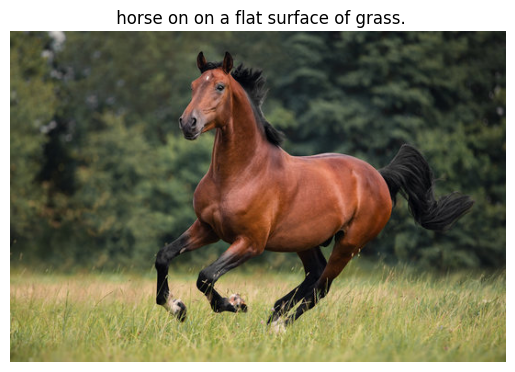

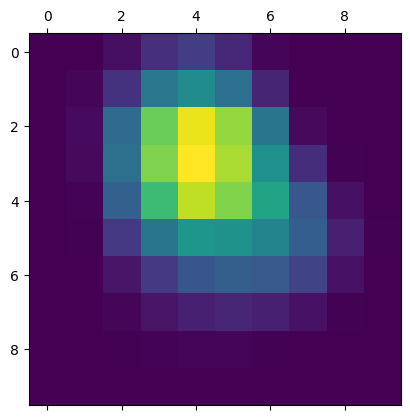

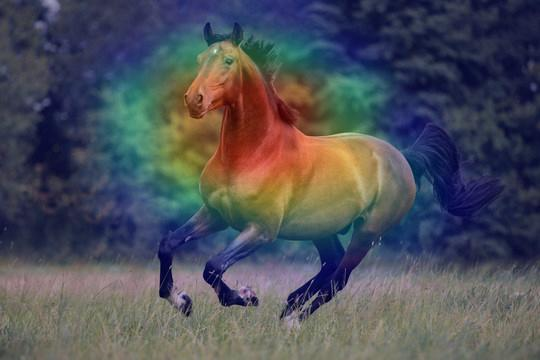

model_final_f10217.pkl: 178MB [00:00, 208MB/s]                           
/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


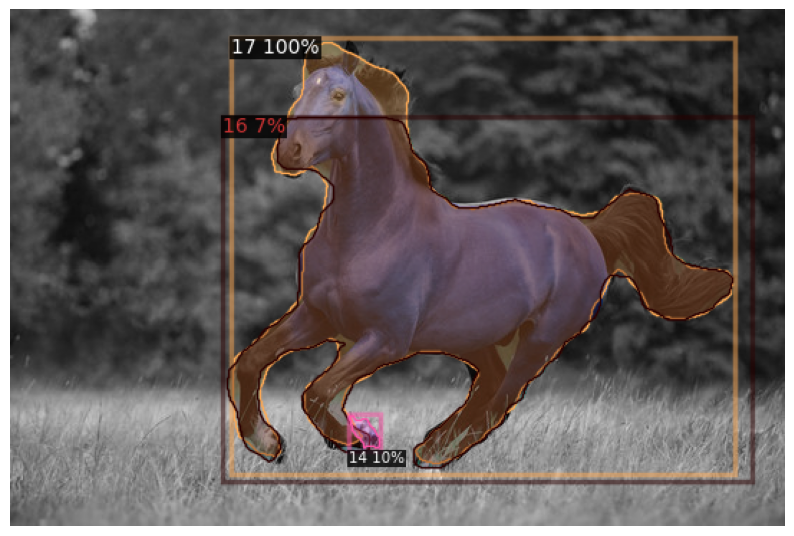

In [ ]:
img_path = '/content/imagess/horse.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)

pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))


# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


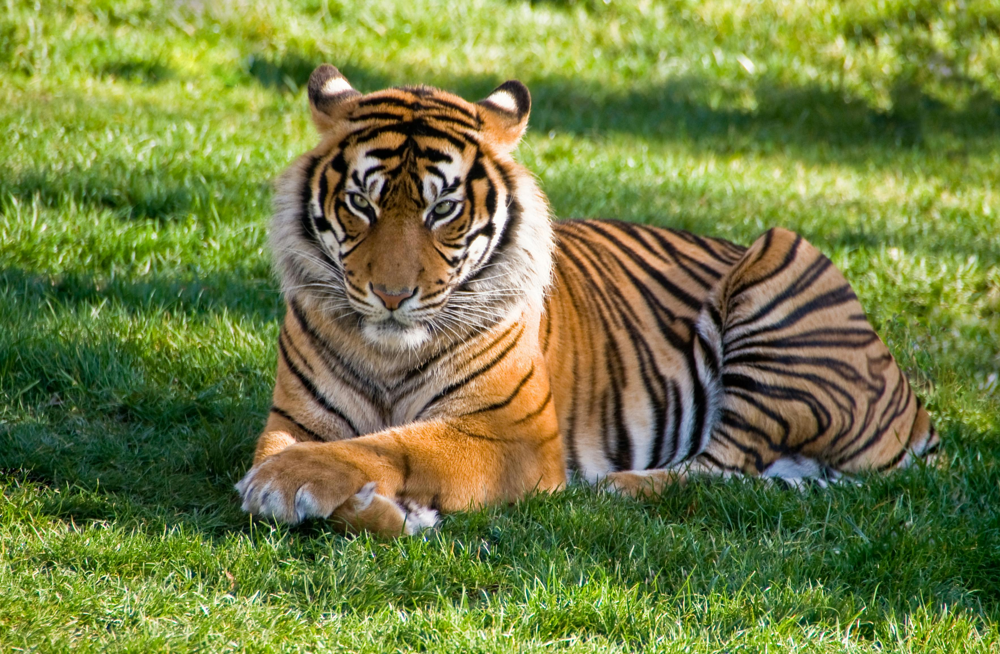

04/05/2024 03:09:45 | [' tiger %% -1.147182', ' Bengal %% -1.7629721', ' Tiger %% -2.3297362', ' lion %% -3.3287864', ' Leopard %% -3.6486483']
04/05/2024 03:09:56 | [' tiger in %% -3.0033083', ' tiger. %% -3.2228532', ' tiger sitting %% -3.240976', ' tiger showing %% -3.2458158', ' tiger resting %% -3.278024']
04/05/2024 03:10:10 | [' tiger.! %% -3.2228532', ' tiger in the %% -3.4406967', ' tiger resting on %% -3.6040075', ' tiger sitting in %% -3.608184', ' tiger sitting on %% -3.608589']
04/05/2024 03:10:24 | [' tiger.!! %% -3.2228532', ' tiger sitting in a %% -3.6365921', ' tiger sitting on a %% -3.665657', ' tiger sitting in the %% -3.7180371', ' tiger resting on a %% -3.825429']
04/05/2024 03:10:39 | [' tiger.!!! %% -3.2228532', ' tiger resting on a grass %% -3.97622', ' tiger sitting in a large %% -4.052739', ' tiger sitting on a white %% -4.053848', ' tiger sitting on a large %% -4.07299']
04/05/2024 03:10:49 | [' tiger.!!!! %% -3.2228532', ' tiger resting on a grass. %% -4.082

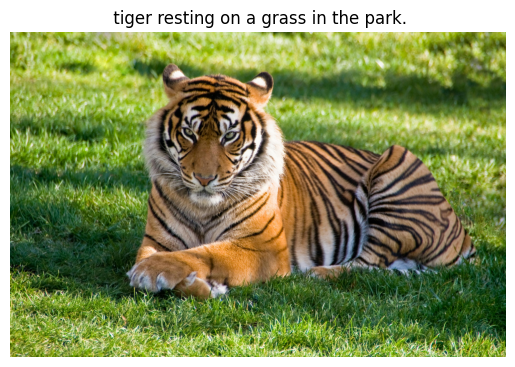

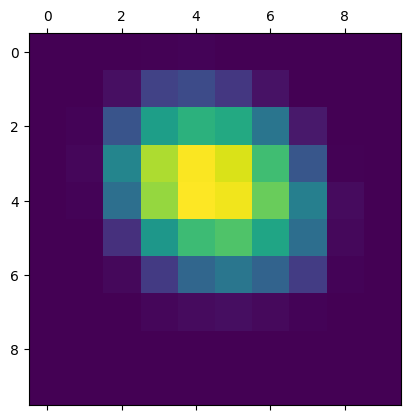

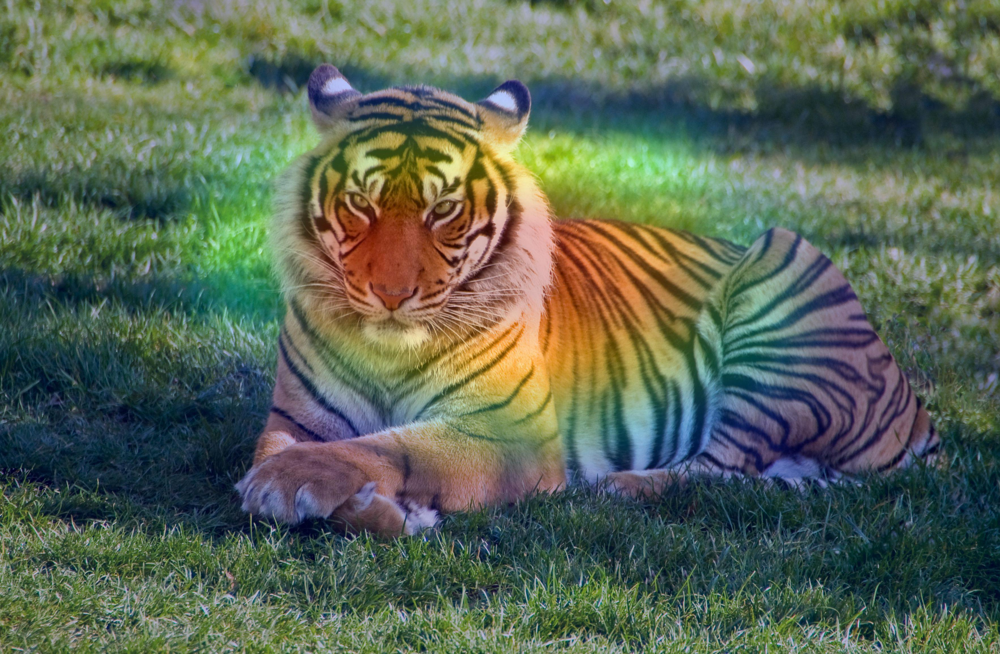

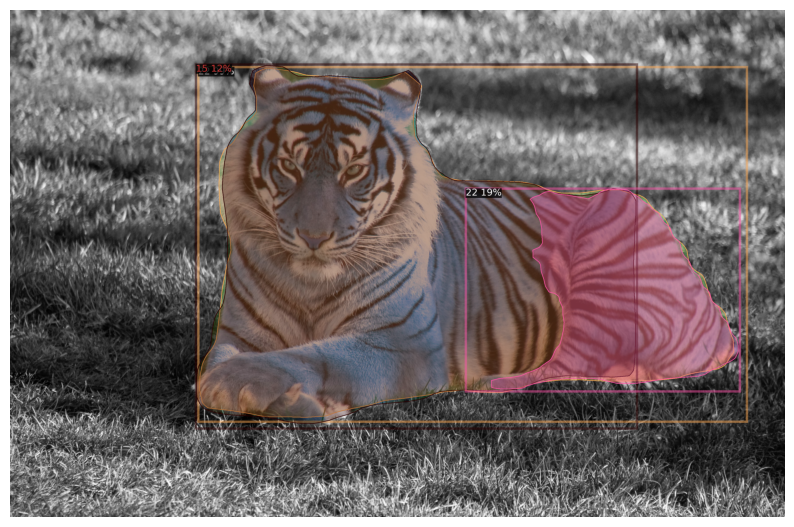

In [ ]:
img_path = '/content/imagess/tiger.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))


# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
# plt.title(best_clip)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


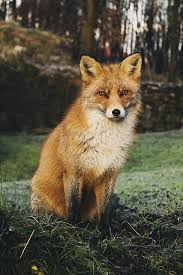

04/05/2024 03:11:39 | [' fox %% -0.67336255', ' Fox %% -2.352731', ' dog %% -4.097626', ' wolf %% -4.441903', ' rac %% -5.090227']
04/05/2024 03:11:49 | [' fox. %% -3.032635', ' fox that %% -3.1005437', ' fox in %% -3.1312234', ' fox I %% -3.309922', ' fox is %% -3.4331622']
04/05/2024 03:12:01 | [' fox.! %% -3.032635', ' fox in the %% -3.5455048', ' fox that was %% -3.7351377', ' fox in a %% -3.7496758', ' fox that has %% -3.8086312']
04/05/2024 03:12:12 | [' fox.!! %% -3.032635', ' fox in the wild %% -4.0166783', ' fox that has been %% -4.0423117', ' fox in the Scottish %% -4.069269', ' fox in the UK %% -4.099754']
04/05/2024 03:12:23 | [' fox.!!! %% -3.032635', ' fox in the wild. %% -3.972505', ' fox in the Scottish National %% -4.256455', ' fox in the wild taken %% -4.2589927', ' fox in the wild by %% -4.281865']
04/05/2024 03:12:33 | [' fox.!!!! %% -3.032635', ' fox in the wild.! %% -3.972505', ' fox in the Scottish National Party %% -4.2843165', ' fox in the Scottish National Ele

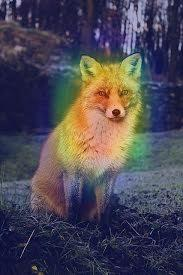

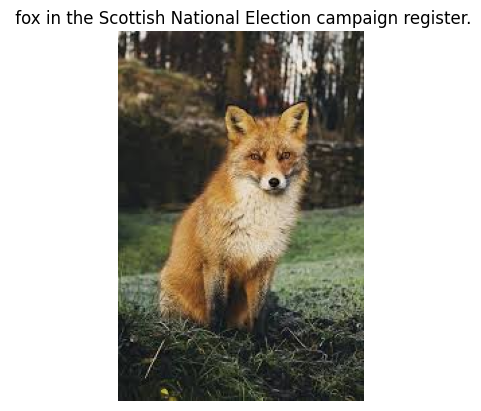

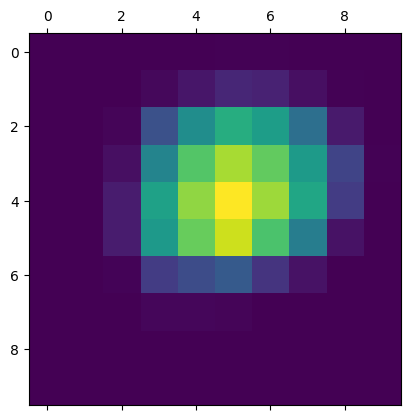

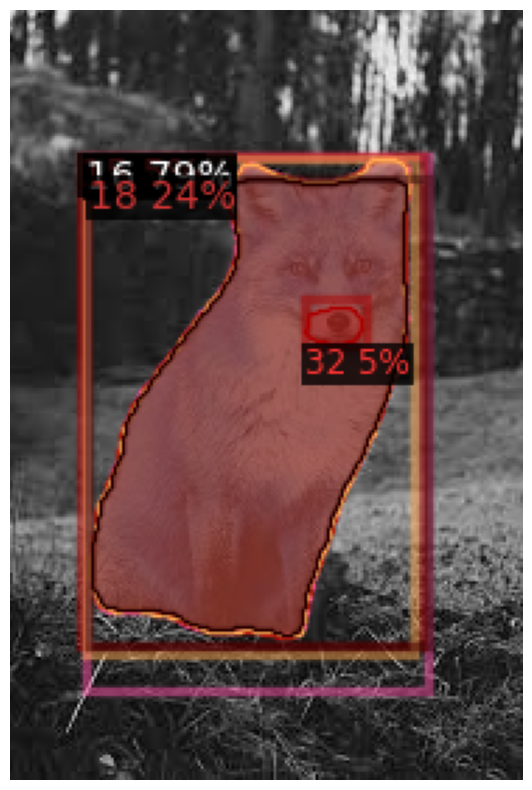

In [ ]:
img_path = "/content/imagess/foxxx.jpeg"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))


# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
# plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


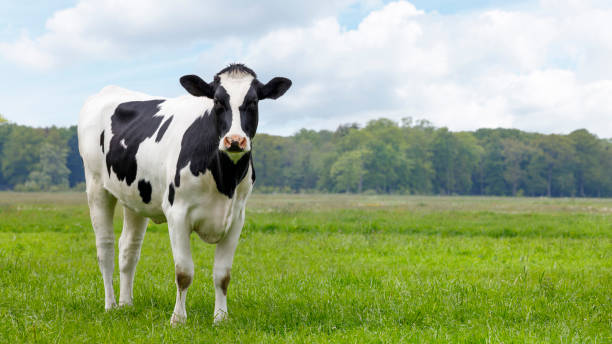

04/05/2024 03:13:17 | [' cow %% -1.5862932', ' Cow %% -2.832498', ' dog %% -4.3385787', ' goat %% -4.5243483', ' donkey %% -4.5366783']
04/05/2024 03:13:27 | [' cow that %% -3.6584764', ' cow in %% -3.700606', ' cow being %% -3.702765', ' cow trying %% -3.7131805', ' cow watching %% -3.7457893']
04/05/2024 03:13:38 | [' cow watching a %% -3.897973', ' cow in the %% -3.9373538', ' cow watching the %% -4.0300736', ' cow trying to %% -4.0428205', ' cow that was %% -4.14752']
04/05/2024 03:13:49 | [' cow watching a field %% -4.3151135', ' cow watching a cow %% -4.3188295', ' cow watching a grass %% -4.355135', ' cow watching a large %% -4.366448', ' cow in the wild %% -4.369858']
04/05/2024 03:14:00 | [' cow watching a grassho %% -4.156113', ' cow in the wild. %% -4.302076', ' cow watching a cow. %% -4.3874707', ' cow in the wild being %% -4.4686155', ' cow watching a field of %% -4.475069']
04/05/2024 03:14:10 | [' cow watching a grasshopper %% -3.776017', ' cow watching a grasshooper %% 

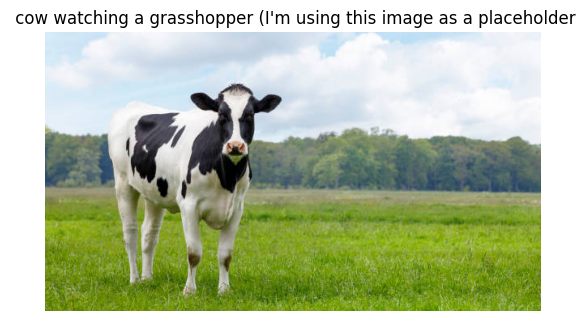

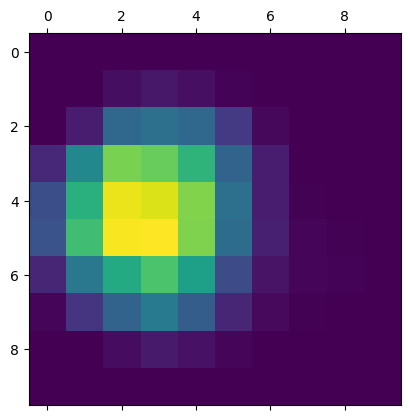

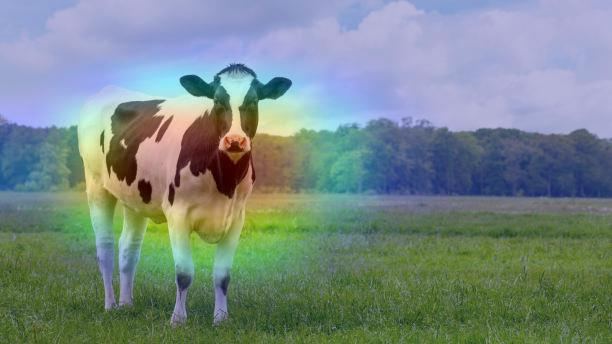

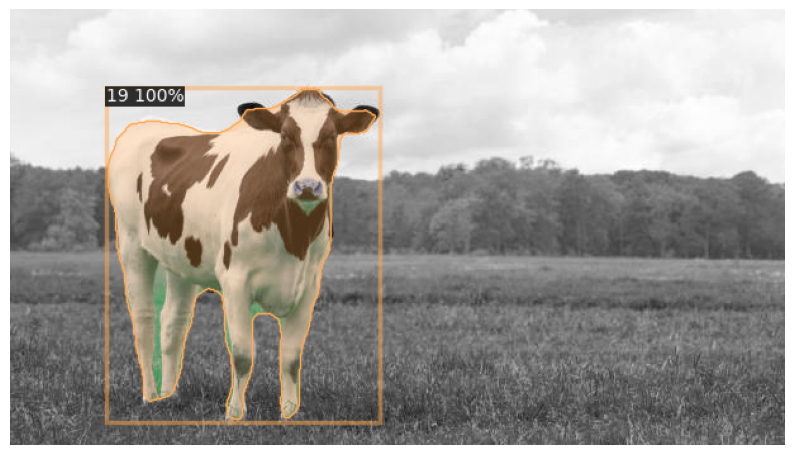

In [ ]:
img_path = '/content/imagess/cow.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))


# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


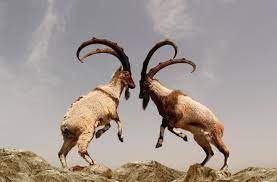

04/05/2024 03:15:59 | [' ram %% -2.6297166', ' goat %% -3.4376392', ' sheep %% -4.356621', ' bull %% -4.8634458', ' man %% -5.0587616']
04/05/2024 03:16:09 | [' ram fight %% -3.0244384', ' ram fights %% -3.3901763', ' sheep fight %% -3.6210895', ' ramfight %% -3.687172', ' ram battle %% -3.7066746']
04/05/2024 03:16:20 | [' ram fight. %% -3.2599976', ' ram fights. %% -3.3538835', ' sheep fight. %% -3.6182823', ' ram fight in %% -3.665756', ' ramfight. %% -3.7181137']
04/05/2024 03:16:31 | [' ram fight.! %% -3.2599976', ' ram fights.! %% -3.3538835', ' sheep fight.! %% -3.6182823', ' ramfight.! %% -3.7181137', ' ram fight in the %% -4.006908']
04/05/2024 03:16:41 | [' ram fight.!! %% -3.2599976', ' ram fights.!! %% -3.3538835', ' sheep fight.!! %% -3.6182823', ' ramfight.!! %% -3.7181137', ' ram fight in the Syrian %% -4.148955']
04/05/2024 03:16:52 | [' ram fight.!!! %% -3.2599976', ' ram fights.!!! %% -3.3538835', ' sheep fight.!!! %% -3.6182823', ' ramfight.!!! %% -3.7181137', ' ram 

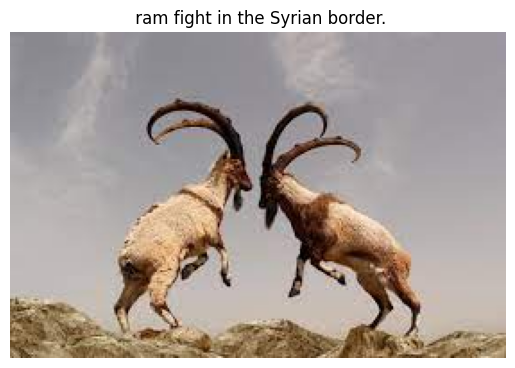

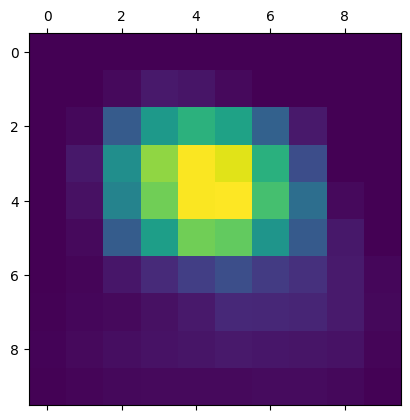

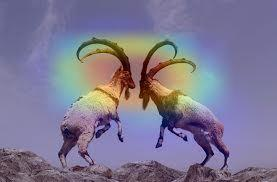

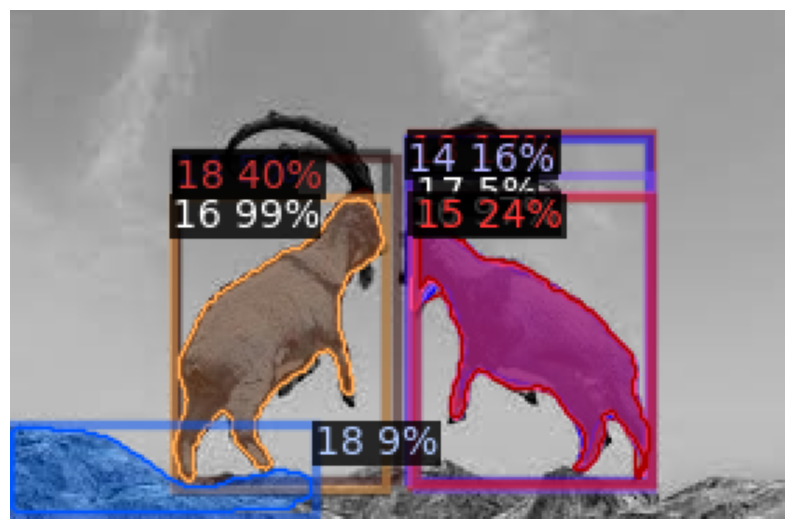

In [ ]:
img_path = '/content/imagess/animals.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


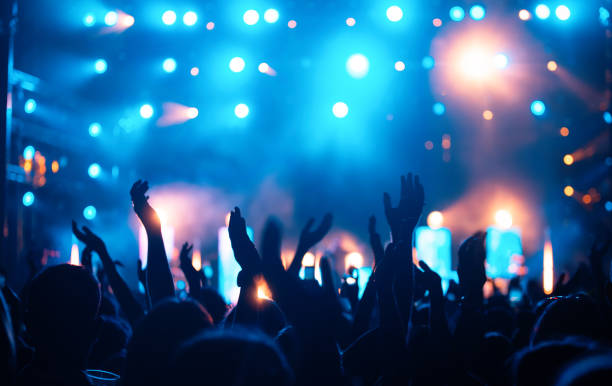

04/05/2024 03:17:15 | [' concert %% -0.8205484', ' performance %% -3.7313316', ' Concert %% -3.74298', ' live %% -3.7927804', ' show %% -4.622043']
04/05/2024 03:17:25 | [' concert. %% -2.7514791', ' concert in %% -2.91471', ' concert being %% -2.948923', ' concert with %% -3.0902257', ' concert at %% -3.1792865']
04/05/2024 03:17:36 | [' concert.! %% -2.7514791', ' concert being a %% -3.5073407', ' concert with a %% -3.5622752', ' concert with the %% -3.6606243', ' concert being the %% -3.6762838']
04/05/2024 03:17:46 | [' concert.!! %% -2.7514791', ' concert being a popular %% -3.9793792', ' concert with a video %% -4.0087767', ' concert being a " %% -4.051567', ' concert with the " %% -4.067591']
04/05/2024 03:17:57 | [' concert.!!! %% -2.7514791', ' concert with a video streaming %% -4.2435784', ' concert being a "concert %% -4.249198', ' concert with a video player %% -4.3356876', ' concert with a video sharing %% -4.344504']
04/05/2024 03:18:08 | [' concert.!!!! %% -2.7514791', '

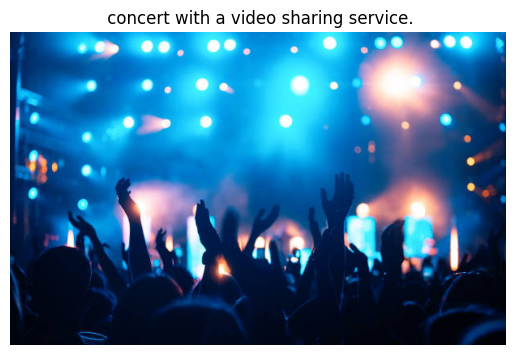

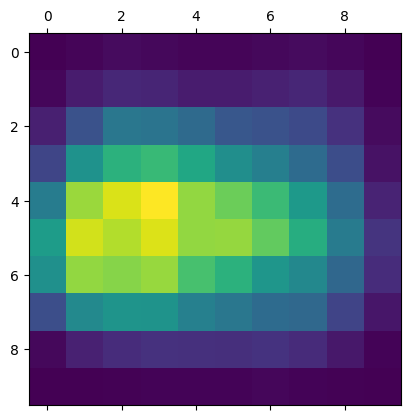

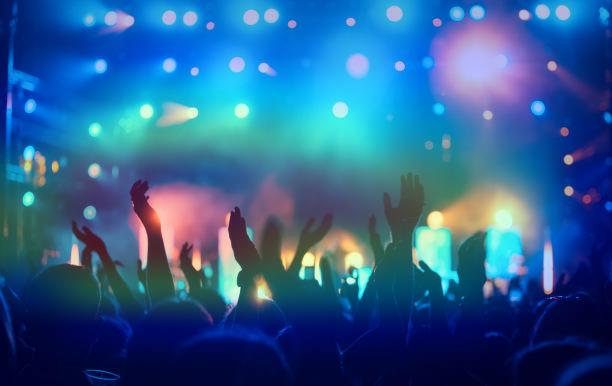

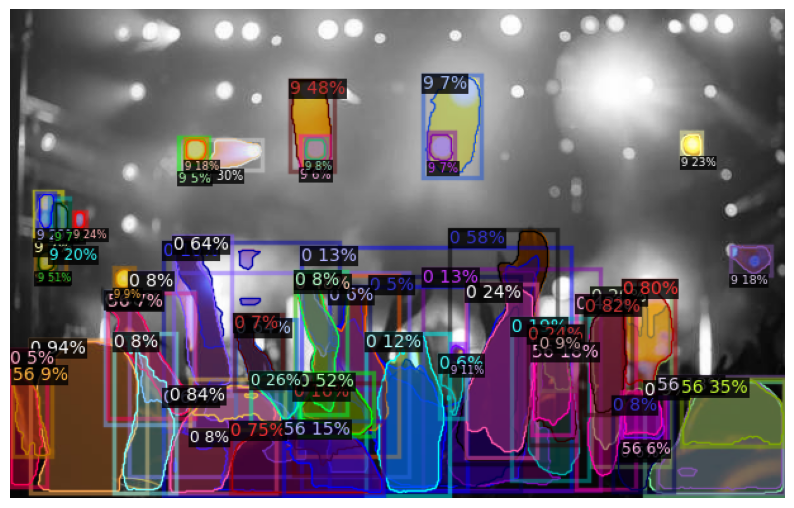

In [ ]:
img_path = '/content/imagess/party.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

best_clip = calc_best_clip(text_generator, captions, image_features)
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

In [ ]:
# prompt: print hello world


print("hello world")


hello world


Input image:


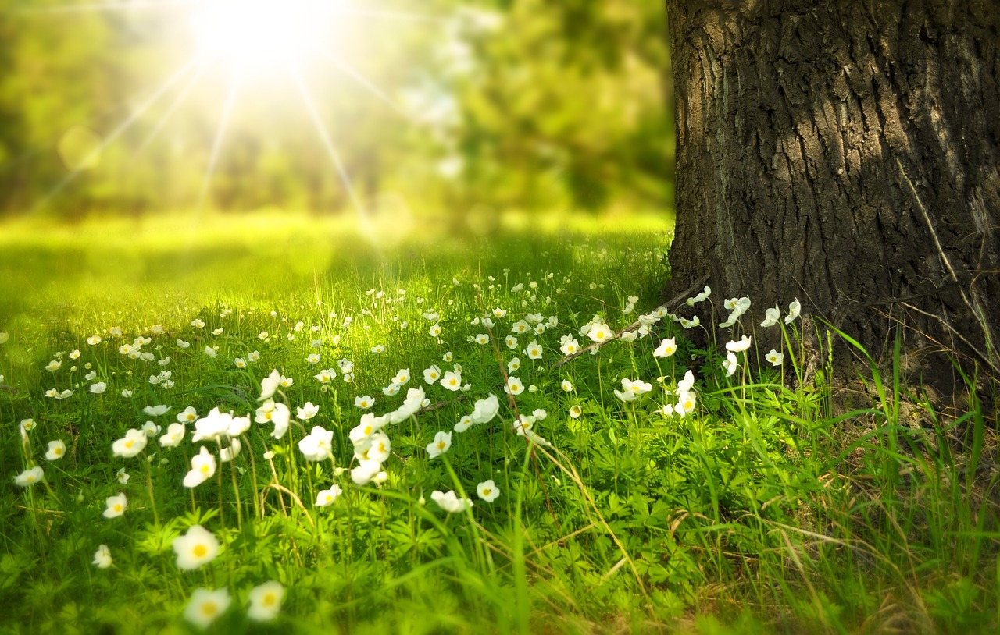

04/05/2024 03:19:57 | [' field %% -2.3236737', ' garden %% -2.6053557', ' sunny %% -3.1457825', ' lawn %% -3.3858247', ' forest %% -3.6990407']
04/05/2024 03:20:08 | [' field. %% -3.4795365', ' field in %% -3.4835725', ' sunny spring %% -3.6811302', ' sunny tree %% -3.8591373', ' field on %% -3.8841288']
04/05/2024 03:20:18 | [' field.! %% -3.4795365', ' field in bloom %% -3.563007', ' field in the %% -3.7706368', ' sunny spring. %% -3.7837455', ' field in Spring %% -3.7878826']
04/05/2024 03:20:29 | [' field.!! %% -3.4795365', ' sunny spring.! %% -3.7837455', ' field in bloom is %% -3.8732228', ' field in bloom will %% -3.924602', ' field in bloom means %% -3.95811']
04/05/2024 03:20:40 | [' field.!!! %% -3.4795365', ' sunny spring.!! %% -3.7837455', ' field in bloom is from %% -3.999728', ' field in bloom is courtesy %% -4.002501', ' field in bloom is © %% -4.036986']
04/05/2024 03:20:50 | [' field.!!!! %% -3.4795365', ' sunny spring.!!! %% -3.7837455', ' field in bloom is from Shutt

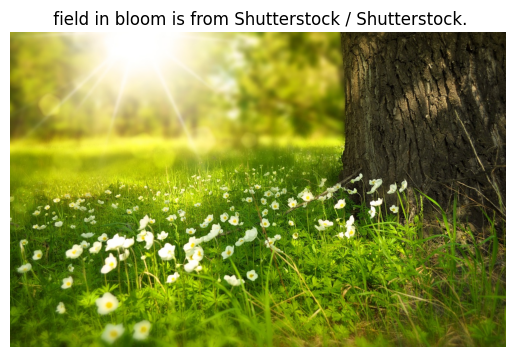

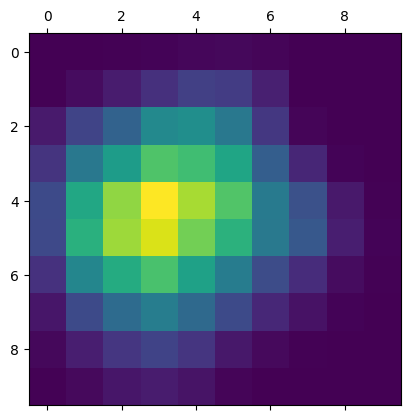

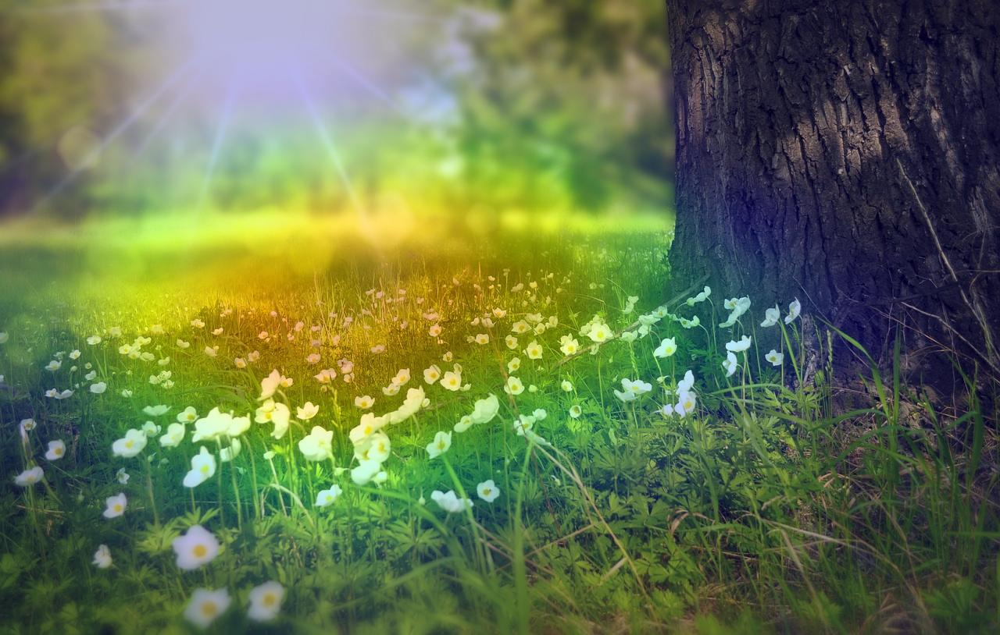

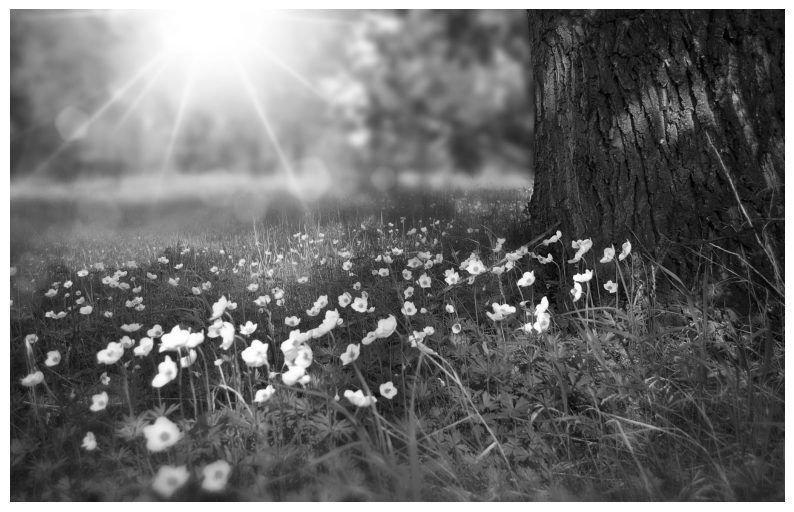

In [ ]:
img_path = '/content/imagess/flowers-276014_1280.jpg'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


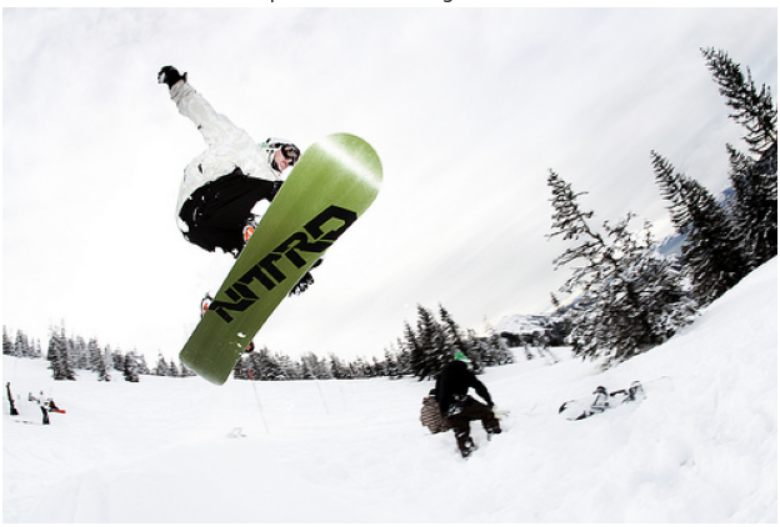

04/05/2024 03:21:34 | [' crash %% -2.6115425', ' shot %% -3.5722048', ' high %% -4.0396433', ' video %% -4.1929483', ' fire %% -4.359723']
04/05/2024 03:21:44 | [' crash skiing %% -2.6200533', ' crash ski %% -2.7460265', ' shot slide %% -3.3545928', ' crash sk %% -3.4895825', ' crash sled %% -3.8145614']
04/05/2024 03:21:55 | [' crash skier %% -3.2651432', ' crash skiing jump %% -3.372166', ' shot slide showing %% -3.412718', ' crash skiing. %% -3.4394524', ' crash skiing in %% -3.5567389']
04/05/2024 03:22:06 | [' crash skiing.! %% -3.4394524', ' crash skier hits %% -3.7646239', ' shot slide showing the %% -3.7802613', ' crash skiing jump shot %% -3.79045', ' crash skier jumps %% -3.8408582']
04/05/2024 03:22:16 | [' crash skiing.!! %% -3.4394524', ' crash skier jumps from %% -3.8789496', ' crash skier jumps. %% -3.8884654', ' crash skiing jump shot. %% -3.9897485', ' crash skier jumps in %% -4.022648']
04/05/2024 03:22:27 | [' crash skiing.!!! %% -3.4394524', ' crash skier jumps.! %%

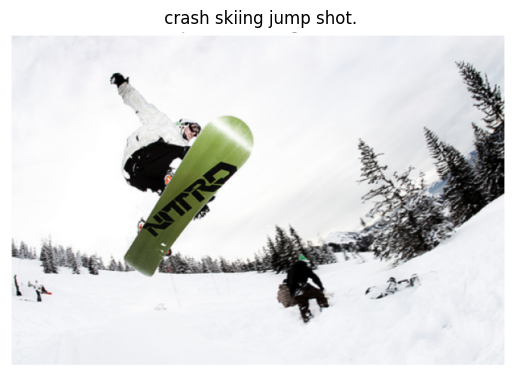

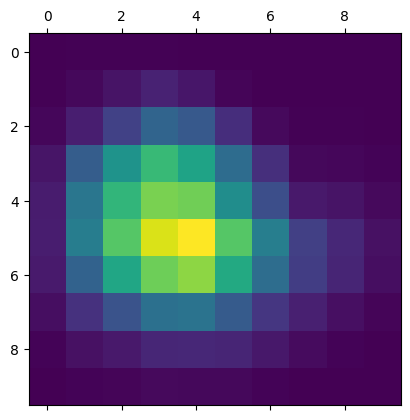

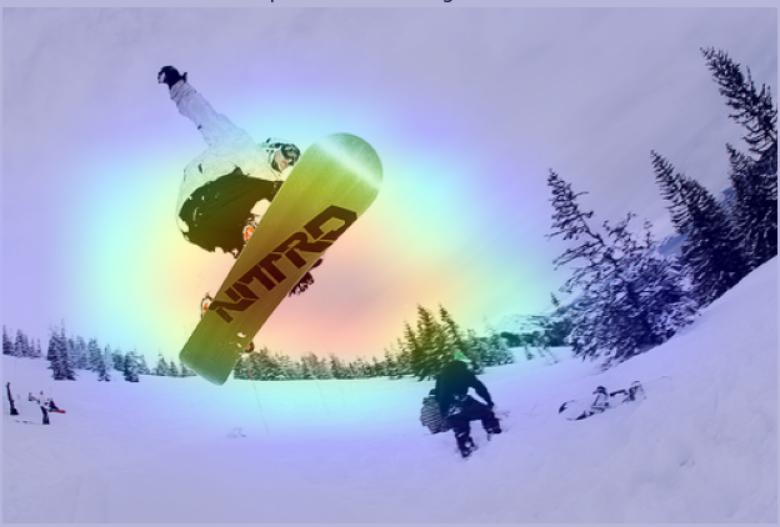

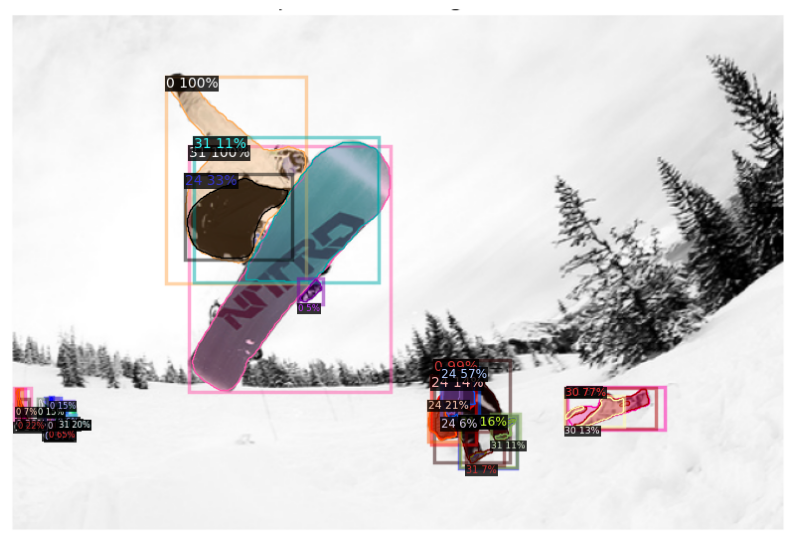

In [ ]:
img_path = '/content/imagess/skating.png'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


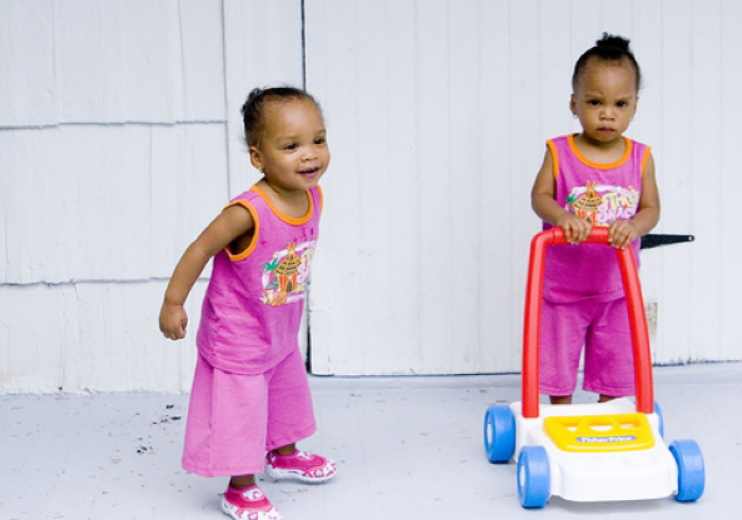

04/05/2024 03:24:16 | [' toddler %% -4.1592946', ' little %% -4.3380365', ' simple %% -4.5299406', ' new %% -4.545393', ' child %% -4.6216254']
04/05/2024 03:24:27 | [' little kids %% -3.9761024', ' little children %% -4.2237616', ' little girls %% -4.3138247', ' simple toddler %% -4.3437185', ' child walk %% -4.5274525']
04/05/2024 03:24:37 | [' little children walk %% -4.272854', ' little children walking %% -4.4366755', ' little kids face %% -4.43706', " little kids' %% -4.4846787", ' little kids in %% -4.516544']
04/05/2024 03:24:48 | [' little kids in pink %% -4.3493133', ' little children walking. %% -4.445778', ' little children walking with %% -4.468527', ' little children walking in %% -4.5107474', ' little children walk- %% -4.523982']
04/05/2024 03:24:59 | [' little children walking.! %% -4.445778', ' little children walking in a %% -4.495846', ' little kids in pink and %% -4.5467668', ' little kids in pink p %% -4.5741363', ' little kids in pink le %% -4.5771704']
04/05/202

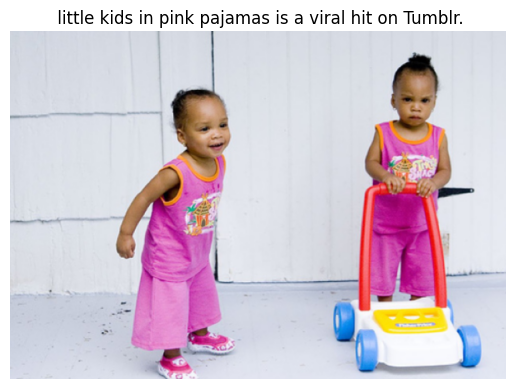

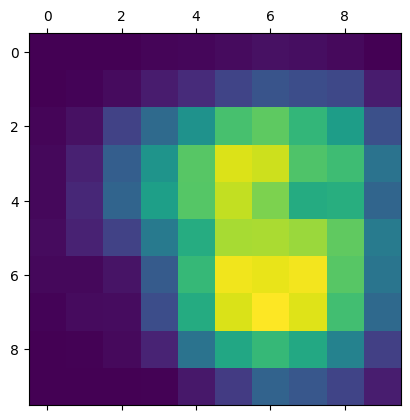

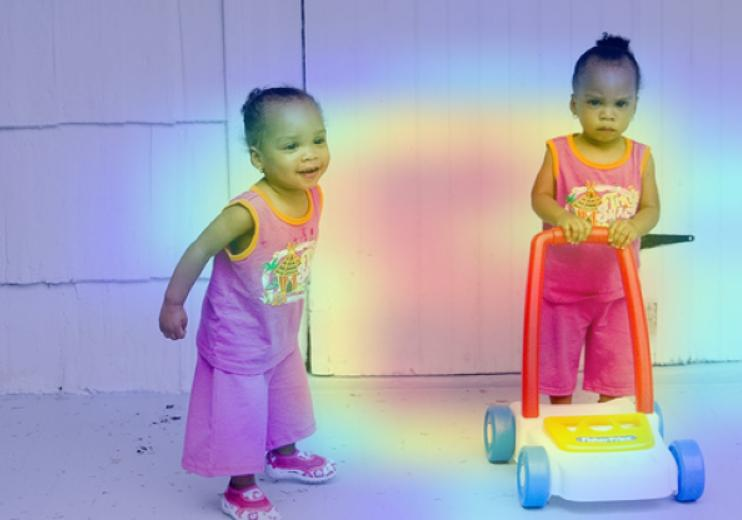

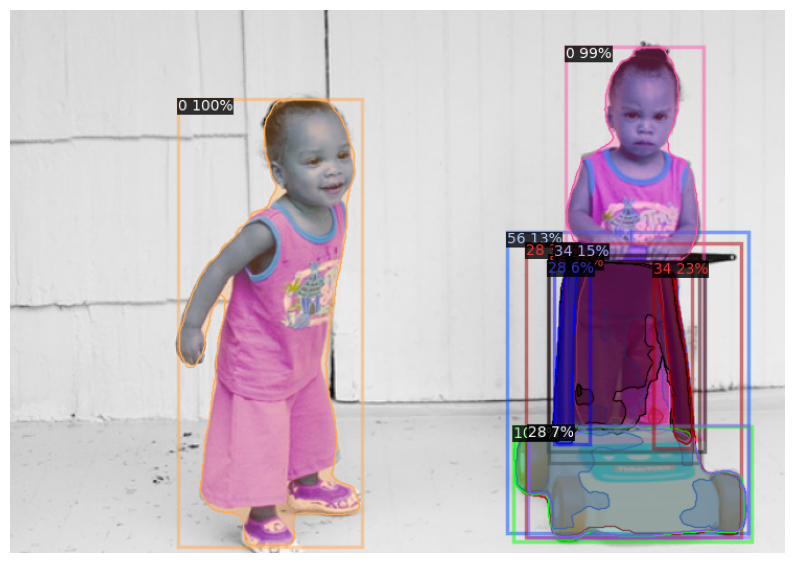

In [ ]:
img_path = '/content/imagess/girls.png'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


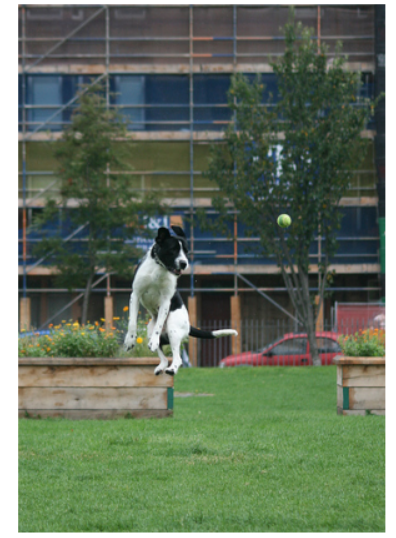

04/05/2024 03:26:48 | [' dog %% -1.7001765', ' Dog %% -2.7371166', ' flying %% -2.8486342', ' Flying %% -3.04248', ' horse %% -3.9823818']
04/05/2024 03:26:59 | [' dog jumping %% -2.6085205', ' flying dog %% -2.769246', ' FlyingDog %% -2.8434637', ' Dog jumping %% -2.895513', ' dog leaping %% -2.9566383']
04/05/2024 03:27:09 | [' dog jumping. %% -3.308318', ' FlyingDog training %% -3.4643414', ' dog jumping from %% -3.4711773', ' FlyingDog jumping %% -3.4728644', ' dog jumping pose %% -3.4968078']
04/05/2024 03:27:20 | [' dog jumping.! %% -3.308318', ' dog jumping pose. %% -3.613372', ' dog jumping from building %% -3.6940699', ' FlyingDog training a %% -3.7370775', ' dog jumping from roof %% -3.7664976']
04/05/2024 03:27:31 | [' dog jumping.!! %% -3.308318', ' dog jumping pose.! %% -3.613372', ' dog jumping from building. %% -3.7620912', ' dog jumping from building in %% -3.917598', ' dog jumping from building ( %% -3.9762688']
04/05/2024 03:27:42 | [' dog jumping.!!! %% -3.308318', '

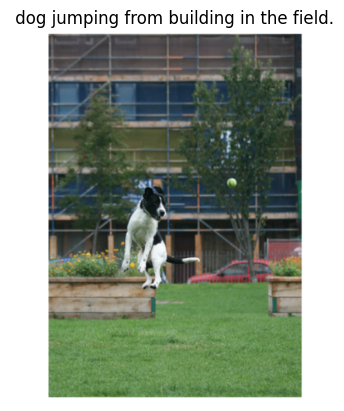

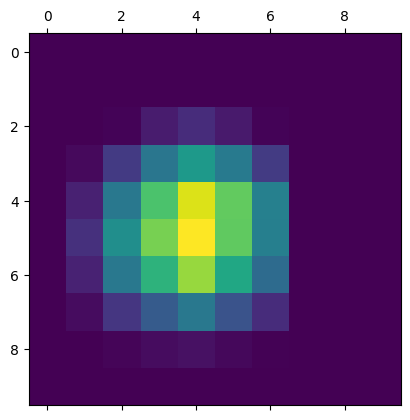

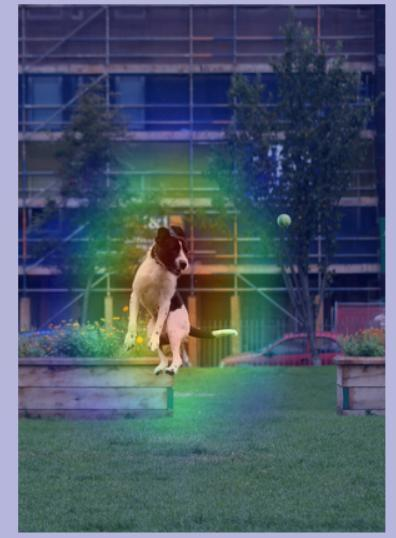

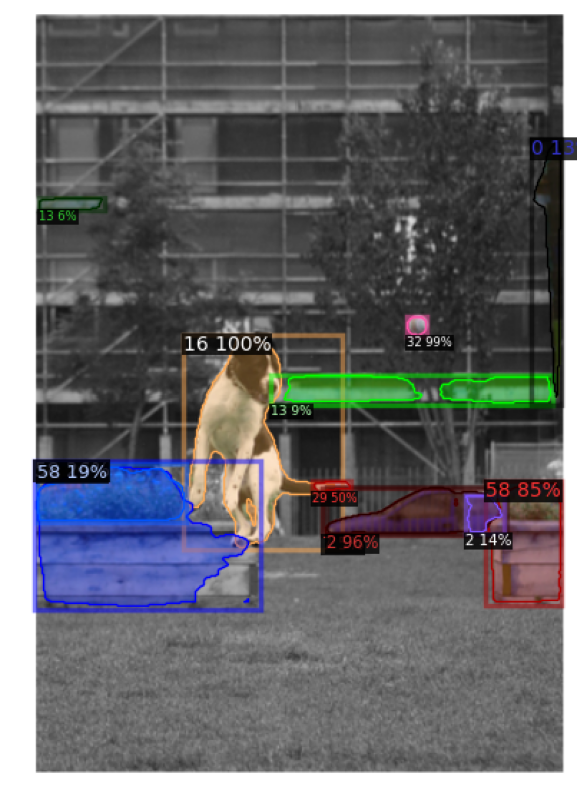

In [ ]:
img_path = '/content/imagess/godplay.png'
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


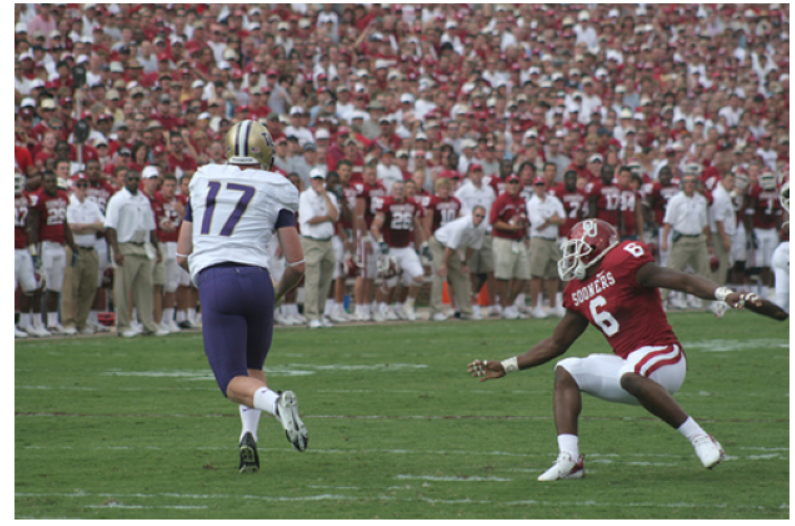

04/05/2024 03:28:15 | [' game %% -2.8102481', ' replay %% -2.853154', ' play %% -2.8814385', ' pass %% -3.476681', ' touchdown %% -3.6634583']
04/05/2024 03:28:25 | [' game interception %% -2.9715781', ' replay. %% -3.4582605', ' game touchdown %% -3.635405', ' game fumble %% -3.8299446', ' game- %% -3.9063954']
04/05/2024 03:28:36 | [' game interception. %% -3.3942165', ' replay.! %% -3.4582605', ' game interception is %% -3.6791315', ' game interception in %% -3.7117424', ' game touchdown. %% -3.8166358']
04/05/2024 03:28:47 | [' game interception.! %% -3.3942165', ' replay.!! %% -3.4582605', ' game touchdown.! %% -3.8166358', ' game interception in the %% -3.8783455', ' game interception is taken %% -3.8861988']
04/05/2024 03:28:57 | [' game interception.!! %% -3.3942165', ' replay.!!! %% -3.4582605', ' game touchdown.!! %% -3.8166358', ' game interception is taken from %% -3.8256211', ' game interception is taken. %% -3.9551787']
04/05/2024 03:29:09 | [' game interception.!!! %% -3

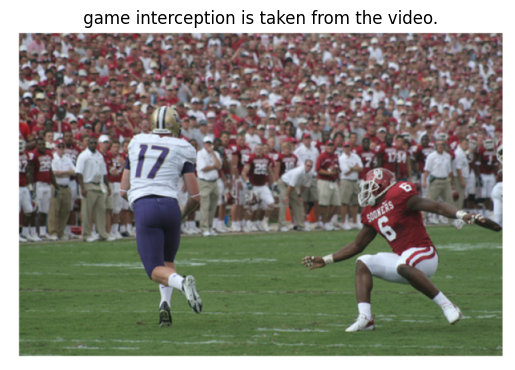

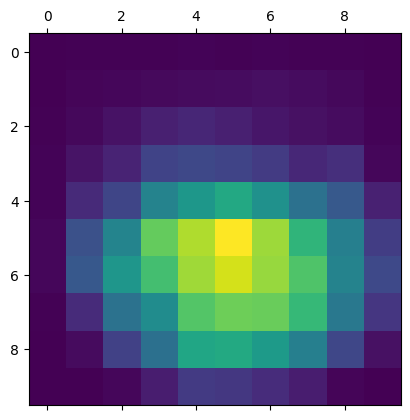

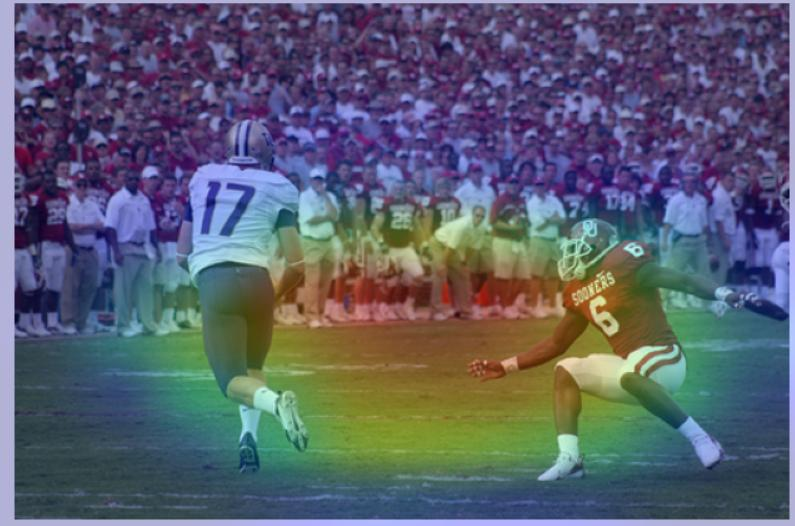

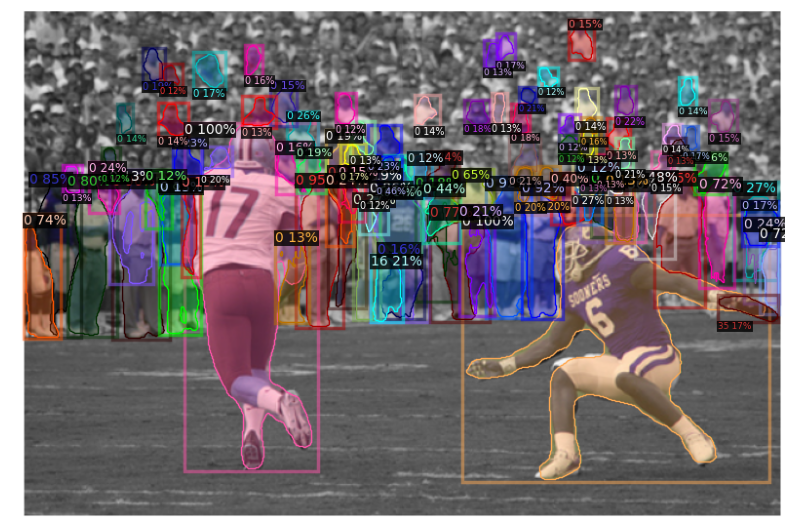

In [ ]:
img_path = "/content/imagess/playing.png"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


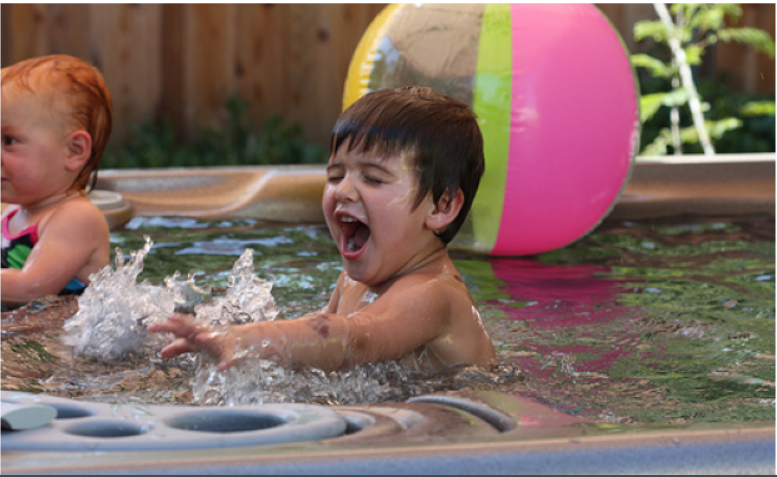

04/05/2024 03:29:43 | [' swimming %% -3.041325', ' baby %% -3.4736924', ' drowning %% -3.540394', ' toddler %% -3.7636938', ' child %% -3.8130136']
04/05/2024 03:29:53 | [' baby swim %% -3.3594737', ' child swimming %% -3.5459805', ' swimming toddler %% -3.6219292', ' baby pool %% -3.6220617', ' swimming child %% -3.705328']
04/05/2024 03:30:04 | [' swimming child screaming %% -3.779209', ' child swimming in %% -3.8379657', ' baby swimmer %% -3.9232216', ' child swimming with %% -3.967596', ' baby swimming %% -4.010446']
04/05/2024 03:30:15 | [' swimming child screaming. %% -3.910697', ' child swimming in the %% -3.9927683', ' child swimming in a %% -4.001383', ' swimming child screaming in %% -4.02291', ' baby swimming. %% -4.1128488']
04/05/2024 03:30:26 | [' swimming child screaming.! %% -3.910697', ' child swimming in a swimming %% -4.050058', ' child swimming in a pool %% -4.069781', ' baby swimming.! %% -4.1128488', ' swimming child screaming in a %% -4.1227217']
04/05/2024 03:30

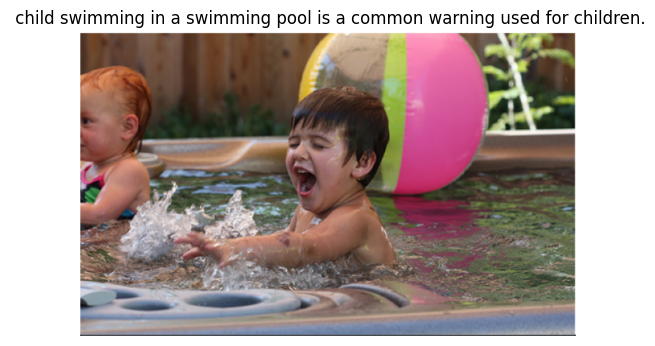

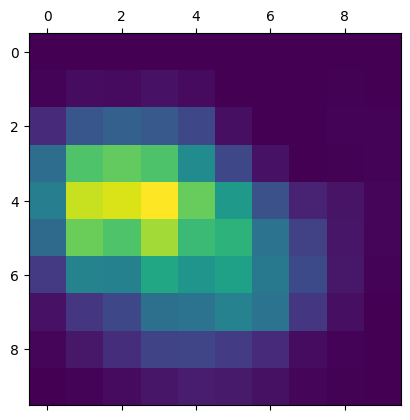

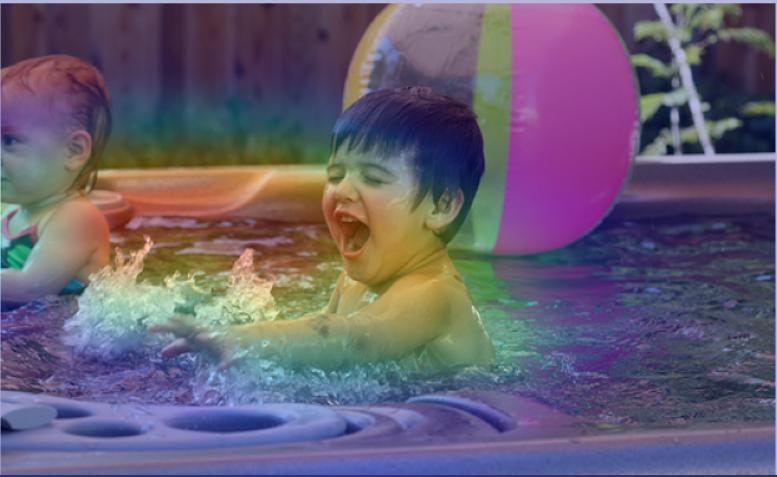

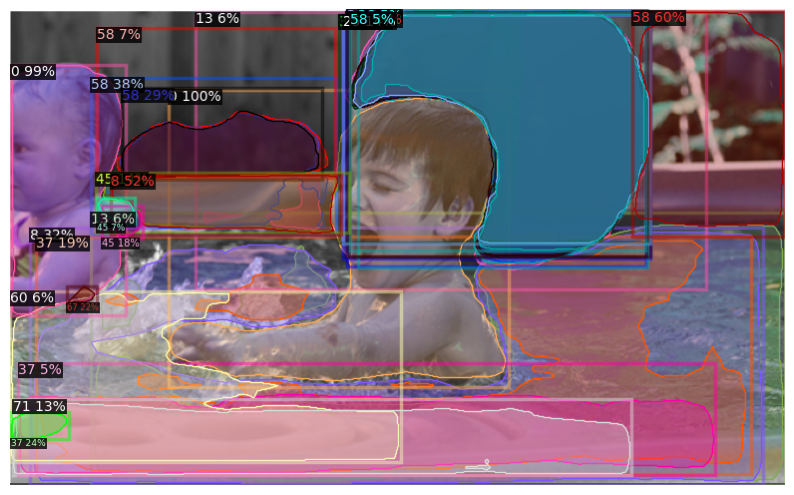

In [ ]:
img_path = "/content/imagess/swimming pool.png"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


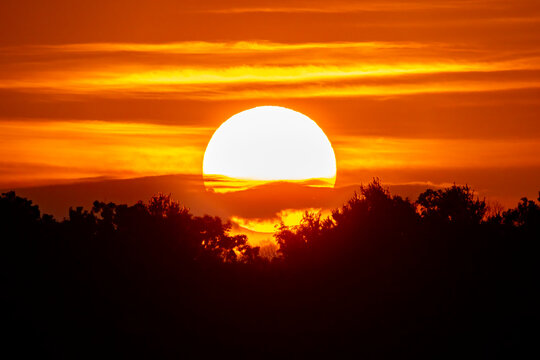

04/05/2024 03:32:27 | [' Sunrise %% -0.27816108', ' sunrise %% -2.4142818', ' sunset %% -2.6450706', ' Sunset %% -4.248383', ' Sun %% -4.797563']
04/05/2024 03:32:37 | [' Sunrise G %% -3.103782', ' Sunrise R %% -3.1994848', ' Sunrise A %% -3.2287858', ' Sunrise Pro %% -3.229889', ' Sunrise S %% -3.242429']
04/05/2024 03:32:47 | [' Sunrise R R %% -2.755292', ' Sunrise A- %% -3.8074512', ' Sunrise G. %% -3.8620846', ' Sunrise Pro- %% -3.9278316', ' Sunrise Projet %% -3.9536684']
04/05/2024 03:32:58 | [' Sunrise R RRP %% -3.561575', ' Sunrise R R. %% -3.5814786', ' Sunrise R Ritz %% -3.596918', ' Sunrise R RSP %% -3.6520562', ' Sunrise R RY %% -3.6691089']
04/05/2024 03:33:09 | [' Sunrise R R.! %% -3.5814786', ' Sunrise R Ritz in %% -3.7892976', ' Sunrise R Ritz- %% -3.8033538', ' Sunrise R Ritz. %% -3.8229187', ' Sunrise R RRP- %% -3.9202263']
04/05/2024 03:33:20 | [' Sunrise R Ritz-Carl %% -3.4405854', ' Sunrise R R.!! %% -3.5814786', ' Sunrise R Ritz.! %% -3.8229187', ' Sunrise R Ritz 

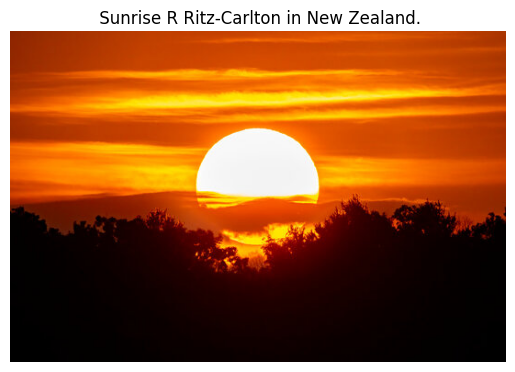

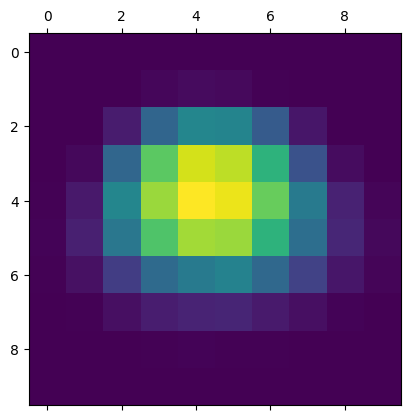

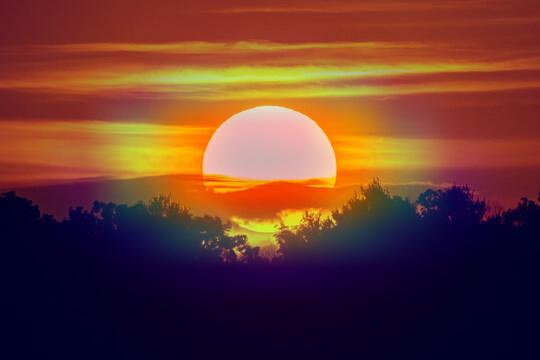

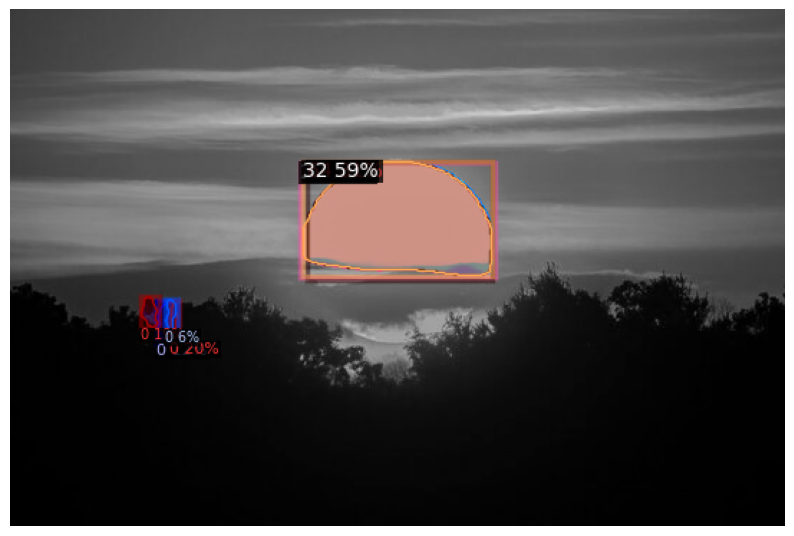

In [ ]:
img_path = "/content/imagess/sun.jpg"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


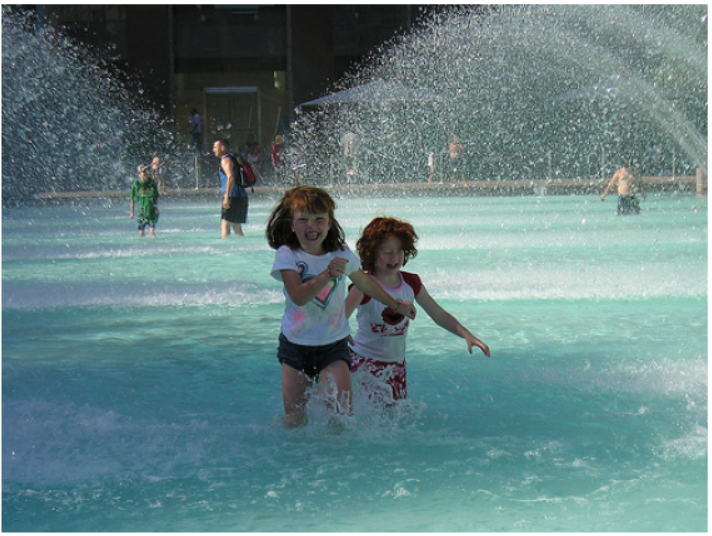

04/05/2024 03:35:09 | [' summer %% -3.2426493', ' day %% -3.251608', ' recent %% -3.739661', ' typical %% -3.7921078', ' night %% -4.083207']
04/05/2024 03:35:19 | [' summer recreation %% -3.4443603', ' day park %% -3.5088882', ' typical summer %% -3.5091796', ' night slide %% -3.6712825', ' summer activity %% -3.7288904']
04/05/2024 03:35:29 | [' summer recreation. %% -3.750069', ' day park activity %% -3.7764657', ' summer recreation in %% -4.0209365', ' night slide with %% -4.0239787', ' typical summer camp %% -4.0700536']
04/05/2024 03:35:40 | [' summer recreation.! %% -3.750069', ' day park activity. %% -3.9215956', ' day park activity that %% -4.049659', ' typical summer camp splash %% -4.106284', ' typical summer camp. %% -4.1112056']
04/05/2024 03:35:51 | [' summer recreation.!! %% -3.750069', ' day park activity.! %% -3.9215956', ' typical summer camp splash. %% -4.0555253', ' typical summer camp.! %% -4.1112056', ' typical summer camp splash in %% -4.2016177']
04/05/2024 03:3

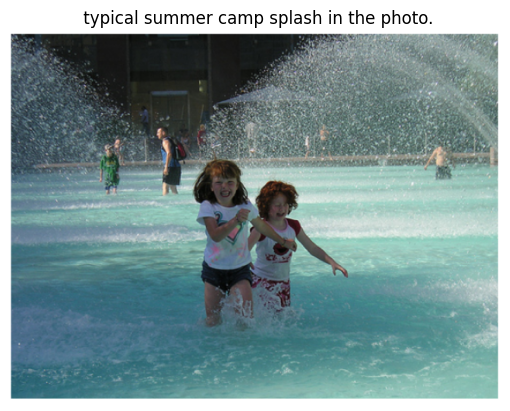

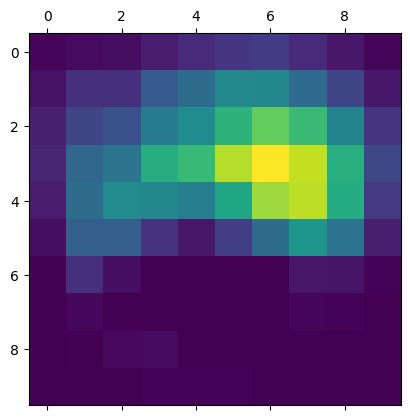

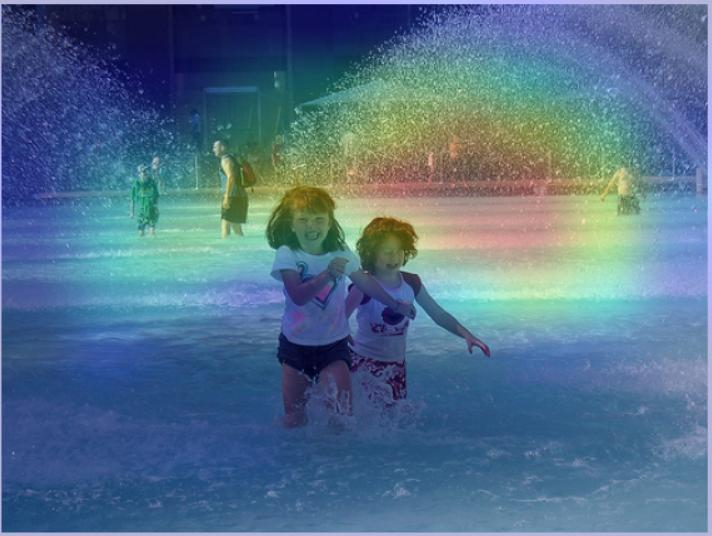

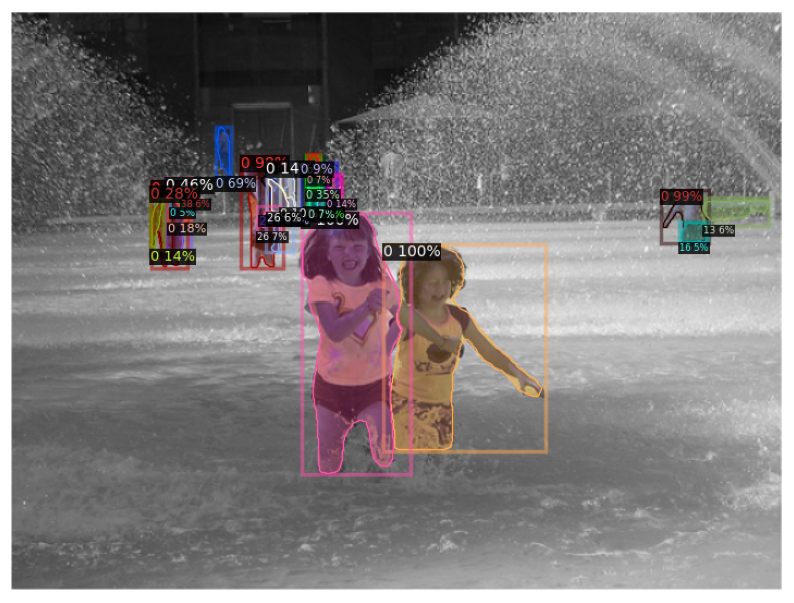

In [ ]:
img_path = "/content/imagess/girlswatere.png"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)

# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)

Input image:


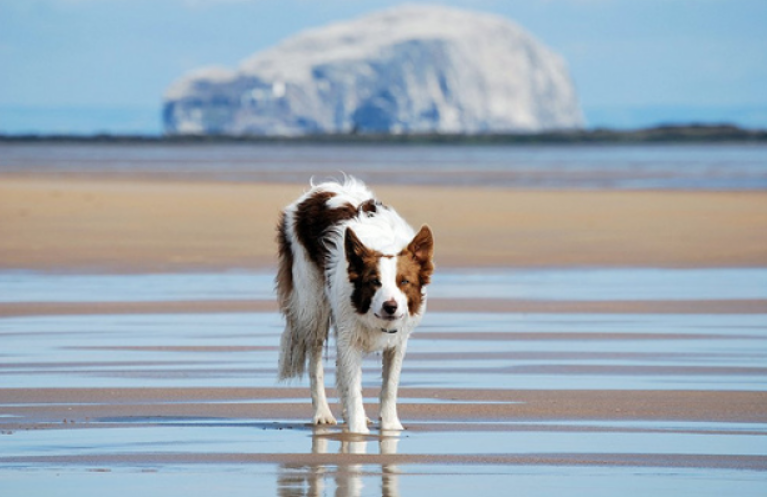

04/05/2024 03:36:34 | [' dog %% -1.7406765', ' Dog %% -1.7460141', ' puppy %% -3.481616', ' Pupp %% -4.0276127', ' pet %% -4.902323']
04/05/2024 03:36:44 | [' Dog Beach %% -2.536352', ' dog exploring %% -3.064664', ' dog wandering %% -3.436512', ' dog stranded %% -3.4505877', ' dog on %% -3.5028157']
04/05/2024 03:36:55 | [' dog exploring beach %% -3.364206', ' Dog Beach in %% -3.384018', ' dog exploring shore %% -3.4795227', ' Dog Beach ( %% -3.4896564', ' dog exploring coastline %% -3.5082467']
04/05/2024 03:37:05 | [' dog exploring coastline. %% -3.7047272', ' Dog Beach in the %% -3.8249226', ' dog exploring beach. %% -3.8287628', ' dog exploring coastline in %% -3.849173', ' dog exploring beach in %% -3.8691564']
04/05/2024 03:37:16 | [' dog exploring coastline.! %% -3.7047272', ' dog exploring beach.! %% -3.8287628', ' dog exploring coastline in the %% -4.0318074', ' dog exploring beach in the %% -4.122203', ' Dog Beach in the middle %% -4.2254133']
04/05/2024 03:37:27 | [' dog ex

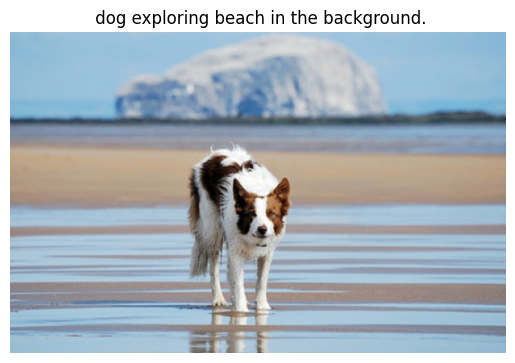

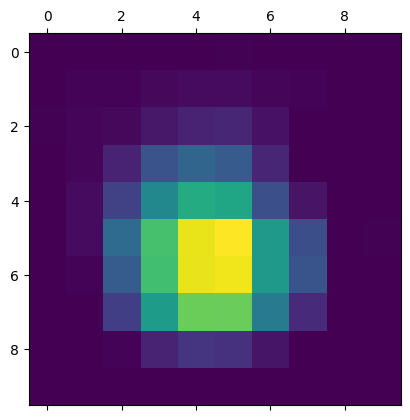

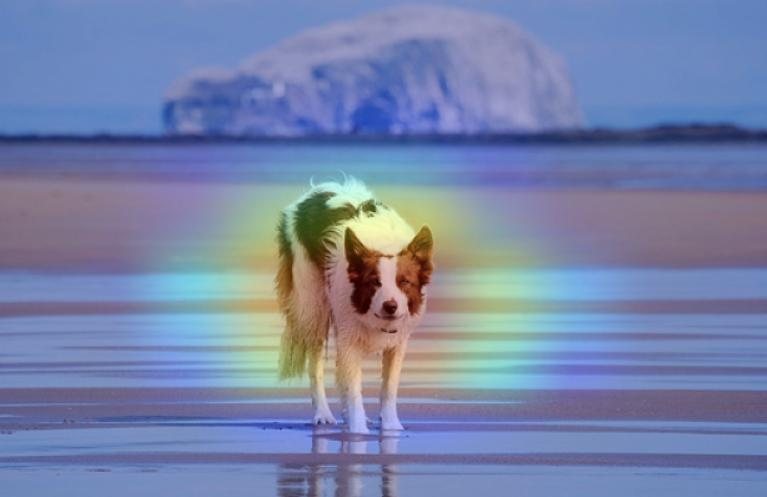

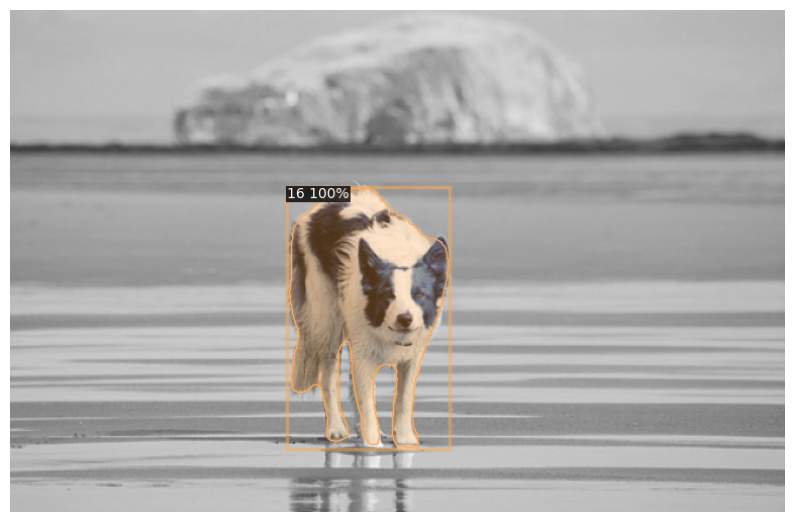

In [ ]:
img_path = "/content/imagess/beach.png"
from IPython.display import Image as IPythonImage, display
print('Input image:')
display(IPythonImage(img_path, width = 300, height = 300))


# captioning_args = get_args(GenType.Captioning)

# # text_generator = CLIPTextGenerator(**dict(captioning_args))
# text_generator = CLIPTextGenerator(captioning_args)

captioning_args = get_args(GenType.Captioning)

text_generator = CLIPTextGenerator(**vars(captioning_args))

image_features = text_generator.get_img_feature([img_path], None)
captions = text_generator.run(image_features, captioning_args.cond_text, beam_size=captioning_args.beam_size)

best_clip = calc_best_clip(text_generator, captions, image_features)

print('all captions:', captions)
best_clip = calc_best_clip(text_generator, captions, image_features)  # Assuming you don't need the index here
print('best clip:', captioning_args.cond_text + best_clip)
pict=plt.imread(img_path)
plt.title(best_clip)
plt.imshow(pict)
plt.axis("off")
# Prepare image
img_array = preprocess_input(get_img_array(img_path, size=img_size))

#
# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
plt.show()

save_and_display_gradcam(img_path, heatmap)
segmented_img(img_path)